## **Pt.4** ST Slide Reflection

In [2]:
import os
import re
import cv2
import random
import numpy as np
import pandas as pd
import glob
import math
import csv
import warnings
from tqdm import tqdm
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import distance, transform
from scipy.interpolate import griddata, Rbf
from skimage.io import imread, imshow
import seaborn as sns
import torch
import tifffile as tiff
import anndata as ad
import spateo as st
import dynamo as dyn
from dynamo.tools import sample
import scanpy as sc
from osgeo import gdal
from numba import cuda
from typing import List
from ELD.utils import (toImg, preprocess, predict_landmarks, create_target_landmarks, 
                       create_target_images, download_images_urls, downscale_images, plot_images, 
                       mask_background, padImg, crop_non_tissue, downsize_and_save, 
                       rescale_landmarks, pad_image_and_adjust_landmarks, corr, plot_warped_images)
# from ELD.model import loadFan, crop, toGrey
from ELD.warp import Homo, Rigid, TPS

os.environ['KMP_DUPLICATE_LIB_OK'] = 'TRUE'
from ddd_bin1 import process_and_visualize_st_bin1, process_and_visualize_st_slide, process_3d_data, generate_uniform_vectors, distance_to_plane_kernel, calculate_distances, get_matchde_3D_slide, Cartesian2Polar, Cartesian2Polar_colorful, plot_polar_scatter, find_max_radius_and_angle, save_image, save_image_colorful, align_manually,apply_transformation_and_save,visualize_aligned_image, visualize_aligned_image_colorful, get_coordinates_and_pixel_values,Feature_Point_Selection_Auto,select_src_points,select_dst_points,Feature_Point_Selection_Manuual,merge_csv_files_by_prefix,generate_mapped_image_with_boundary, generate_mapped_image_with_boundary_colorful, read_csv_points,tps_transform,plot_single_points,tps_transformed,process_matching_and_save_with_cuda
from eee import atlas3D_construction, visualize_single_gene_in3D, visualize_single_gene_inMultiSilce
work_path = 'G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/'

In [3]:
batch = 'HAI24_2'
work_path = f'G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/{batch}/'
binSize = '1'

read ST_bin1

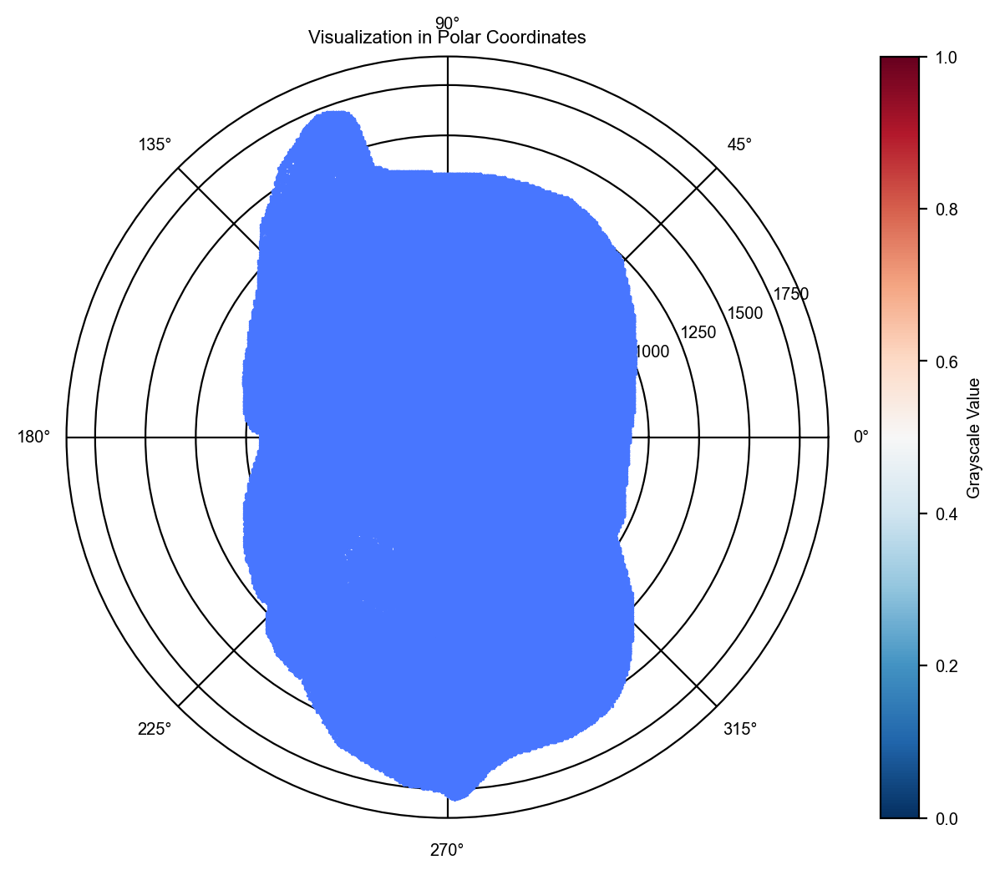

In [4]:
ST_bin1_path = f'{work_path}{batch}_bin{binSize}.gem'
radii_ST_bin1, angles_ST_bin1, coor = process_and_visualize_st_bin1(ST_bin1_path)

read ST_slide

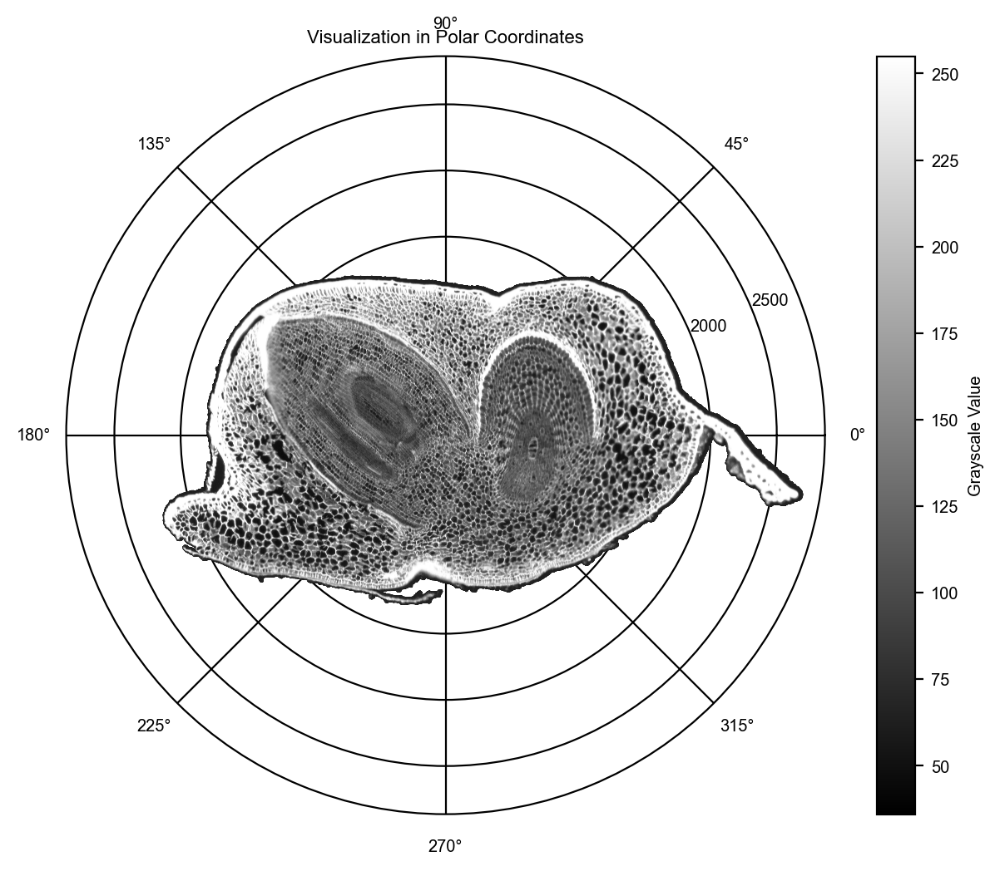

In [5]:
ST_slide_path = f'{work_path}{batch}.png'
radii_ST_slide, angles_ST_slide, value_ST_slide = process_and_visualize_st_slide(ST_slide_path)

read 3D_slice

最大半径: 486.09525649725475
对应的角度 α: 1.6713415972937034


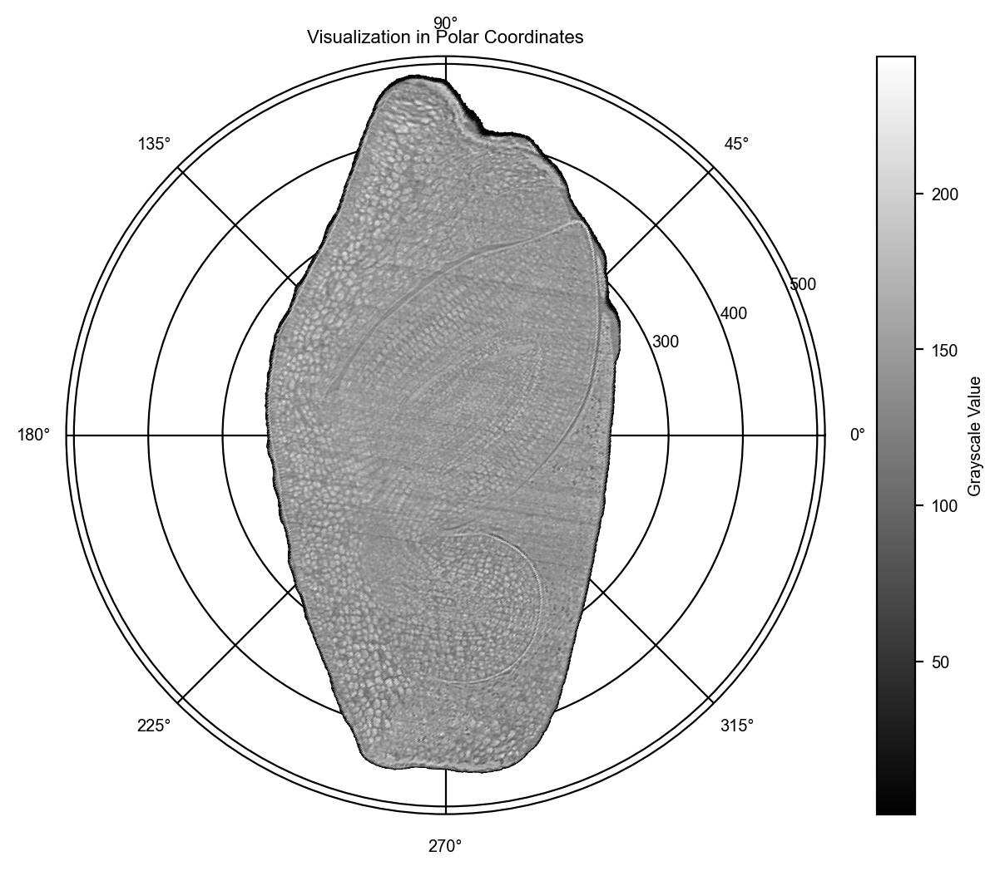

最大半径: 484.0468297408808
对应的角度 α: 1.6579603634167466


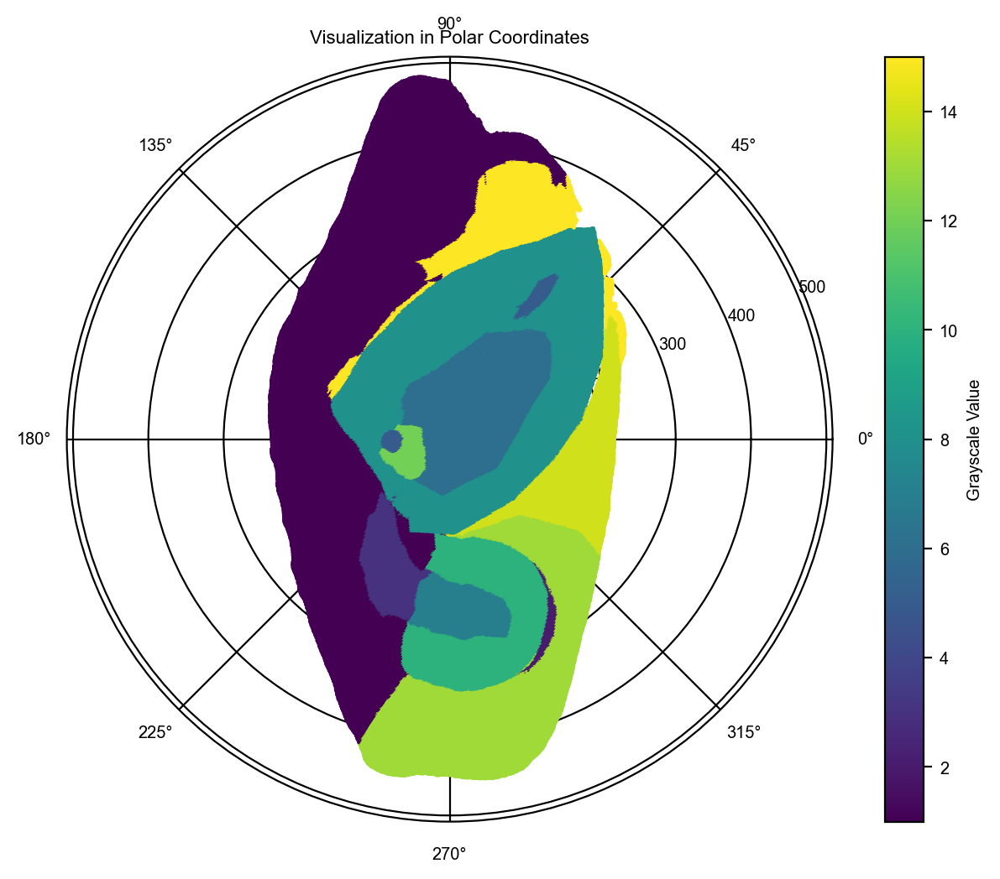

最大半径: 482.2527199940684
对应的角度 α: 1.6661495019423627


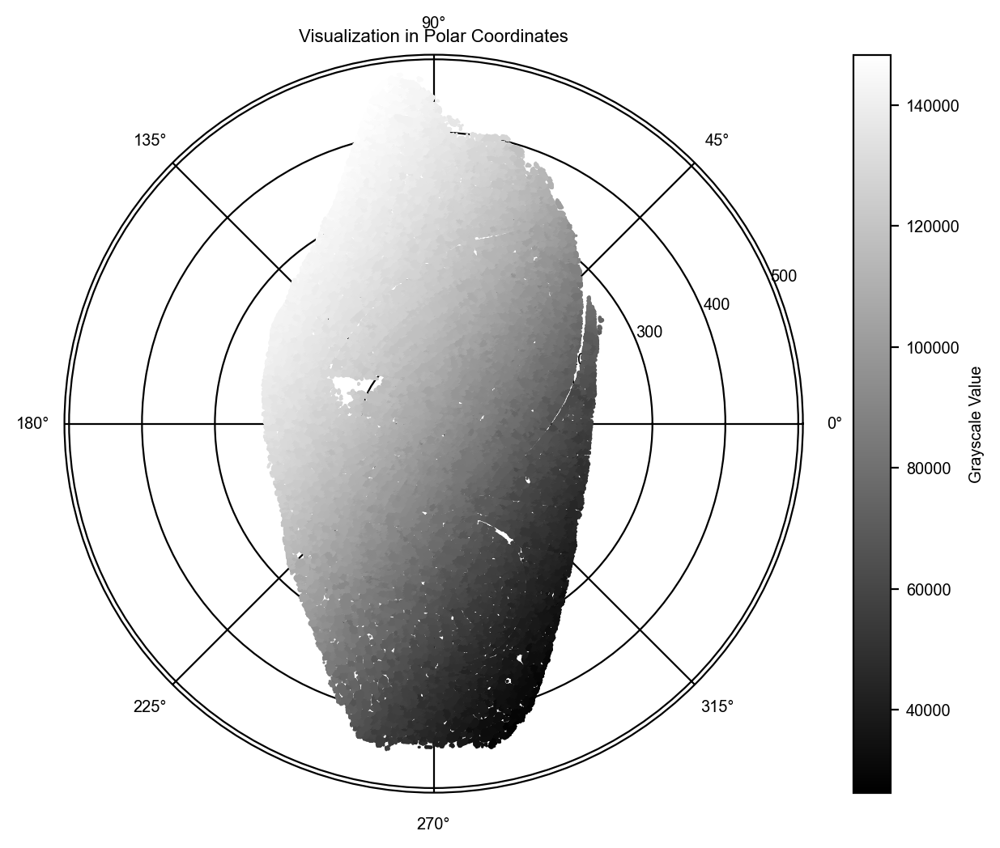

In [6]:
txt_path_3D_origin = 'G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/3D-OriginData/output.txt'
txt_path_3D_cellseg = 'G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/3D-CellSeg/output.txt'
txt_path_3D_tissueseg = 'G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/3D-TissuePreciseSeg-updata03/output.txt'

x_O, y_O, z_O, origin_grayscale, origin_centroid = process_3d_data(txt_path_3D_origin)
x_cs, y_cs, z_cs, cellseg_grayscale, cellseg_centroid = process_3d_data(txt_path_3D_cellseg)
x_ts, y_ts, z_ts, ts_grayscale, ts_centroid = process_3d_data(txt_path_3D_tissueseg)

n = 1000
vectors = generate_uniform_vectors(n)

NUM = 368
I = 2
vector = vectors
# x_O, y_O, z_O, origin_grayscale, origin_centroid 
# x_cs, y_cs, z_cs, cellseg_grayscale, cellseg_centroid
# x_ts, y_ts, z_ts, ts_grayscale, ts_centroid 

rotated_points_origin, rotated_grayscale_origin = get_matchde_3D_slide(NUM, I, 25, vector, x_O, y_O, z_O, origin_centroid, origin_grayscale)
rotated_points_cellseg, rotated_grayscale_cellseg = get_matchde_3D_slide(NUM, I, 25, vector, x_cs, y_cs, z_cs, origin_centroid, cellseg_grayscale)
rotated_points_ts, rotated_grayscale_ts = get_matchde_3D_slide(NUM, I, 25, vector, x_ts, y_ts, z_ts, origin_centroid, ts_grayscale)

centroid = np.mean(rotated_points_origin, axis=0)  # 计算质心
alpha_3D_origin, radii_3D_origin, max_radius_3D_origin, max_alpha_3D_origin = Cartesian2Polar(rotated_points_origin, rotated_grayscale_origin,centroid)
alpha_3D_ts, radii_3D_ts, max_radius_3D_ts, max_alpha_3D_ts = Cartesian2Polar_colorful(rotated_points_ts, rotated_grayscale_ts, centroid)
alpha_3D_cellseg, radii_3D_cellseg, max_radius_3D_cellseg, max_alpha_3D_cellseg = Cartesian2Polar(rotated_points_cellseg, rotated_grayscale_cellseg,centroid)



In [7]:
cellseg_barcodeCount_volume3D = pd.Series(cellseg_grayscale).value_counts().reset_index()
cellseg_barcodeCount_volume3D.columns = ['cellseg_barcode', 'count']
Cellseg_barcodeCount_selectedSlide = pd.Series(rotated_grayscale_cellseg).value_counts().reset_index()
Cellseg_barcodeCount_selectedSlide.columns = ['cellseg_barcode', 'count']
Cellseg_barcodeCount_selectedSlide = pd.merge(Cellseg_barcodeCount_selectedSlide, 
                     cellseg_barcodeCount_volume3D[['cellseg_barcode', 'count']], 
                     on='cellseg_barcode', 
                     how='left', 
                     suffixes=('_selectedSlide', '_volume3D'))
Cellseg_barcodeCount_selectedSlide['ratio'] = Cellseg_barcodeCount_selectedSlide['count_volume3D'] / Cellseg_barcodeCount_selectedSlide['count_selectedSlide']
Cellseg_barcodeCount_selectedSlide['ratio'] = Cellseg_barcodeCount_selectedSlide['ratio'].round().astype(int)

In [8]:
Cellseg_barcodeCount_selectedSlide

,cellseg_barcode,count_selectedSlide,count_volume3D,ratio
0,138686.0,329,2218,7
1,69229.0,325,1803,6
2,67603.0,320,1752,5
3,114096.0,318,1799,6
4,143155.0,307,1619,5
...,...,...,...,...
6144,127719.0,1,196,196
6145,87011.0,1,1037,1037
6146,108784.0,1,435,435
6147,102307.0,1,425,425


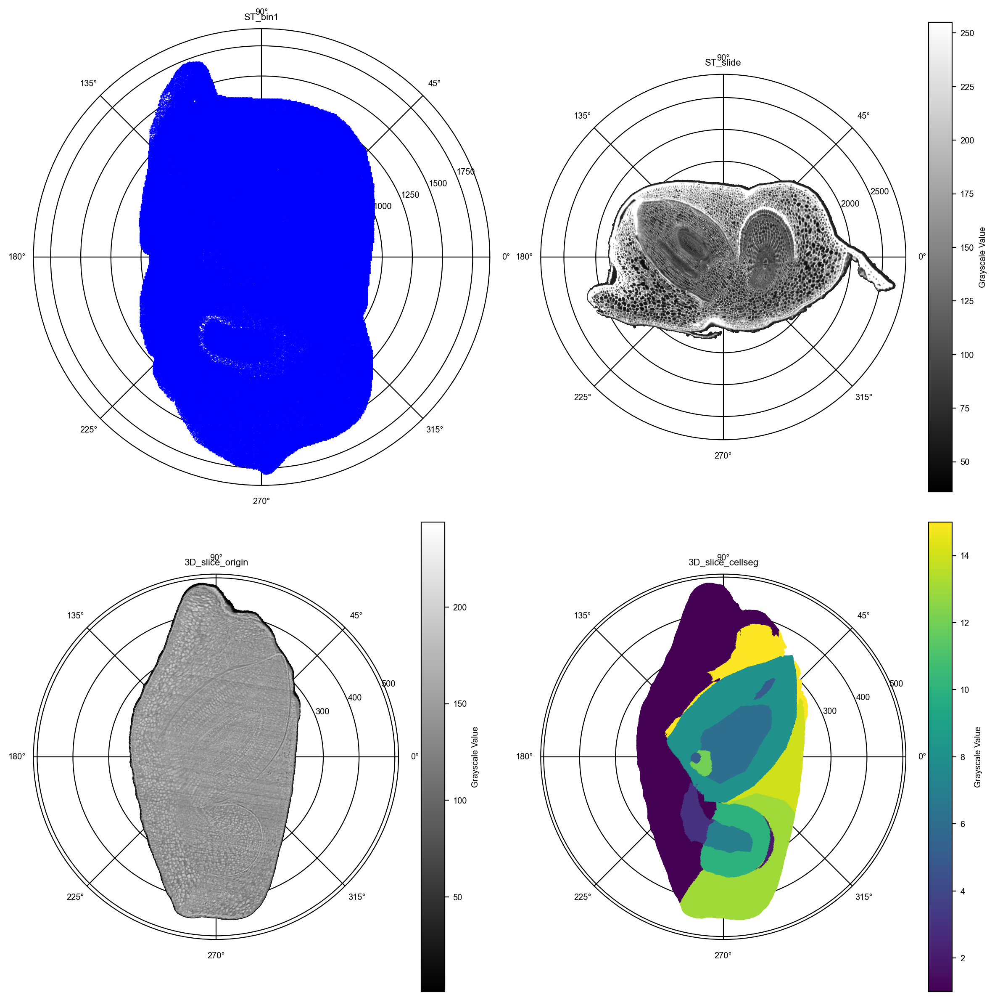

In [9]:
####四组极坐标
#ST_bin1: radii_ST_bin1, angles_ST_bin1
#ST_slide: radii_ST_slide, angles_ST_slide, value_ST_slide
#3D_slice_origin: radii_3D_origin, alpha_3D_origin, rotated_grayscale_origin
#3D_slice_cellseg: radii_3D_cellseg, alpha_3D_cellseg, 
plot_polar_scatter(angles_ST_bin1, radii_ST_bin1, 
                   angles_ST_slide, radii_ST_slide, value_ST_slide,
                   alpha_3D_origin, radii_3D_origin, rotated_grayscale_origin,
                   alpha_3D_ts, radii_3D_ts, rotated_grayscale_ts)

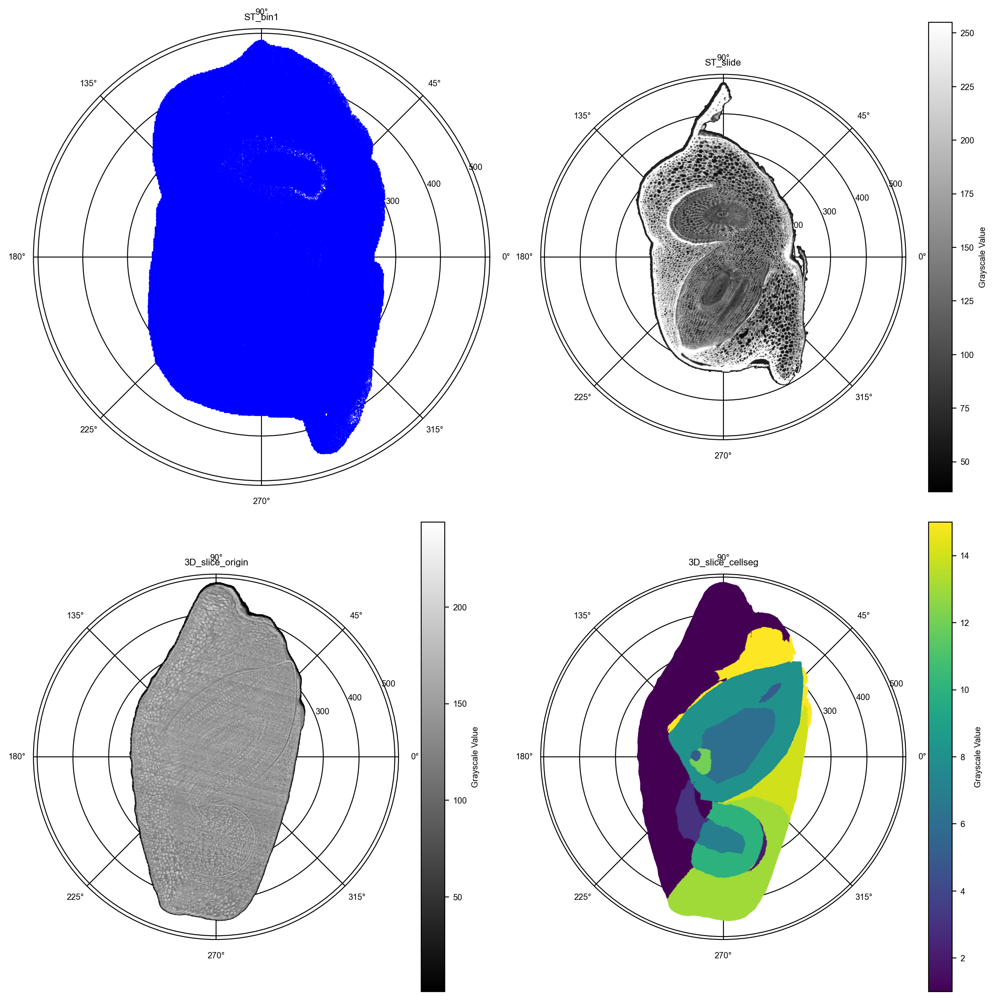

In [10]:
max_radii_ST_bin1, max_angle_ST_bin1 = find_max_radius_and_angle(np.array(radii_ST_bin1), np.array(angles_ST_bin1))
max_radii_ST_slide, max_angle_ST_slide = find_max_radius_and_angle(radii_ST_slide, angles_ST_slide)
max_radii_3D_origin, max_angle_3D_origin = find_max_radius_and_angle(radii_3D_origin, alpha_3D_origin)
max_radii_3D_cellseg, max_angle_3D_cellseg = find_max_radius_and_angle(radii_3D_cellseg, alpha_3D_cellseg)
max_radii_3D_ts, max_angle_3D_ts = find_max_radius_and_angle(radii_3D_ts, alpha_3D_ts)

min_value = min(max_radii_ST_bin1, max_radii_ST_slide, max_radii_3D_origin)
pi = math.pi
ratio = min_value/max_radii_ST_bin1 

radii_ST_bin1_scale = radii_ST_bin1*ratio
angles_ST_bin1_scale = angles_ST_bin1 - max_angle_ST_bin1 + pi/2
coor['radii_ST_bin1_scale'] = radii_ST_bin1_scale
coor['angles_ST_bin1_scale'] = angles_ST_bin1_scale

ratio = min_value/max_radii_ST_slide 
radii_ST_slide_scale = radii_ST_slide*ratio
angles_ST_slide_scale = angles_ST_slide - max_angle_ST_slide + pi/2

ratio = min_value/max_radii_3D_origin 
radii_3D_origin_scale = radii_3D_origin*ratio
alpha_3D_origin_scale = alpha_3D_origin - max_angle_3D_origin + pi/2

ratio = min_value/max_radii_3D_origin 
radii_3D_cellseg_scale = radii_3D_cellseg*ratio
alpha_3D_cellseg_scale = alpha_3D_cellseg - max_angle_3D_cellseg + pi/2

ratio = min_value/max_radii_3D_origin 
radii_3D_ts_scale = radii_3D_ts*ratio
alpha_3D_ts_scale = alpha_3D_ts - max_angle_3D_ts + pi/2

plot_polar_scatter(angles_ST_bin1_scale, radii_ST_bin1_scale, 
                   angles_ST_slide_scale, radii_ST_slide_scale, value_ST_slide,
                   alpha_3D_origin_scale, radii_3D_origin_scale, rotated_grayscale_origin,
                   alpha_3D_ts_scale, radii_3D_ts_scale, rotated_grayscale_ts)

保存scale后的图片用于人工对齐

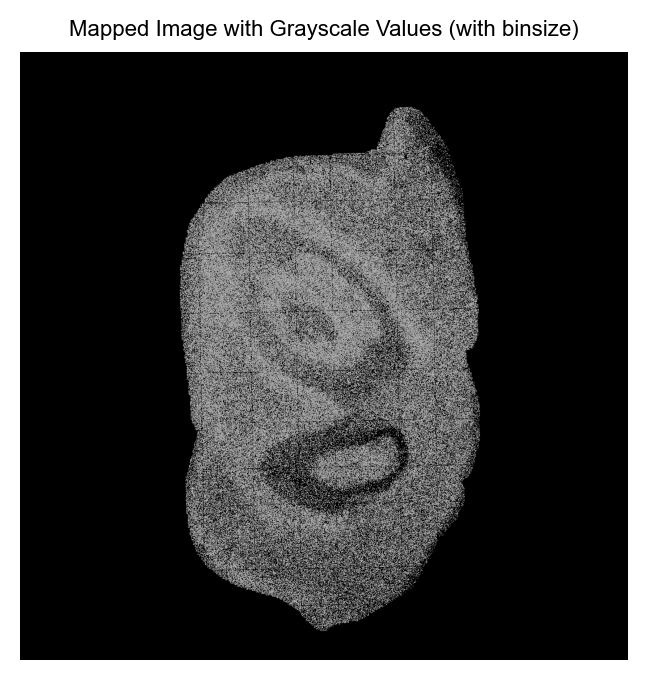

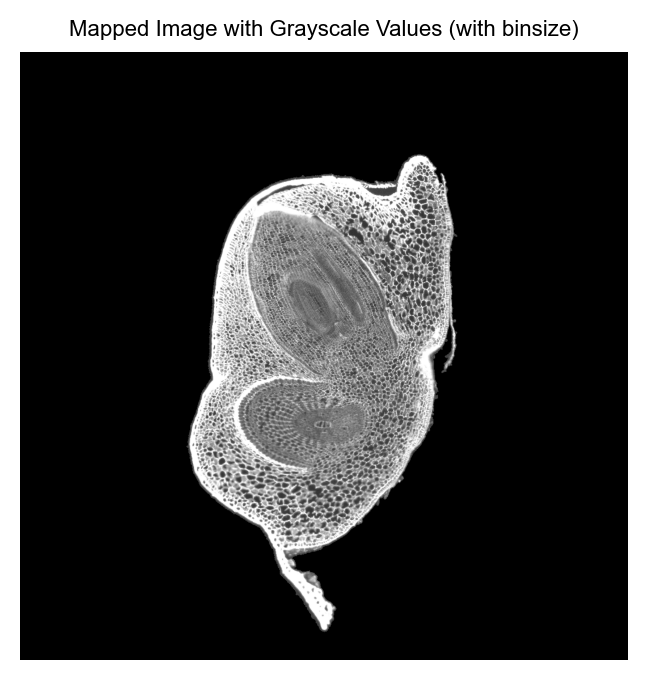

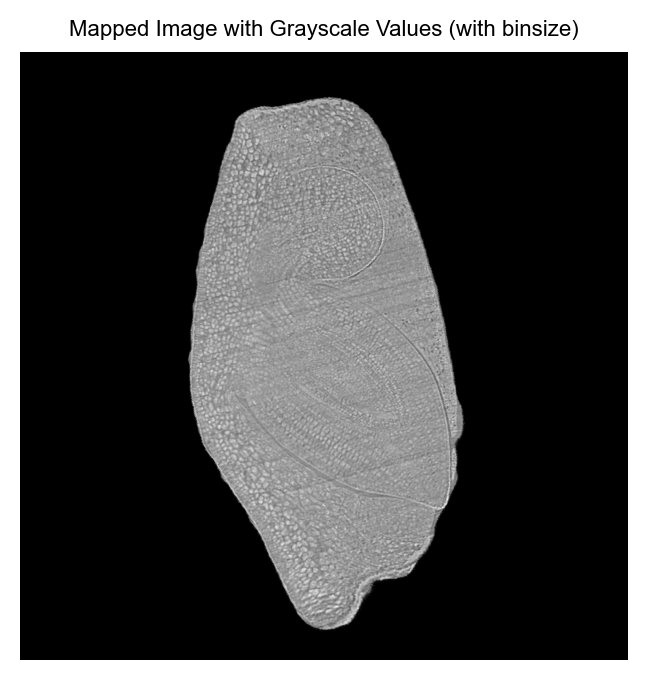

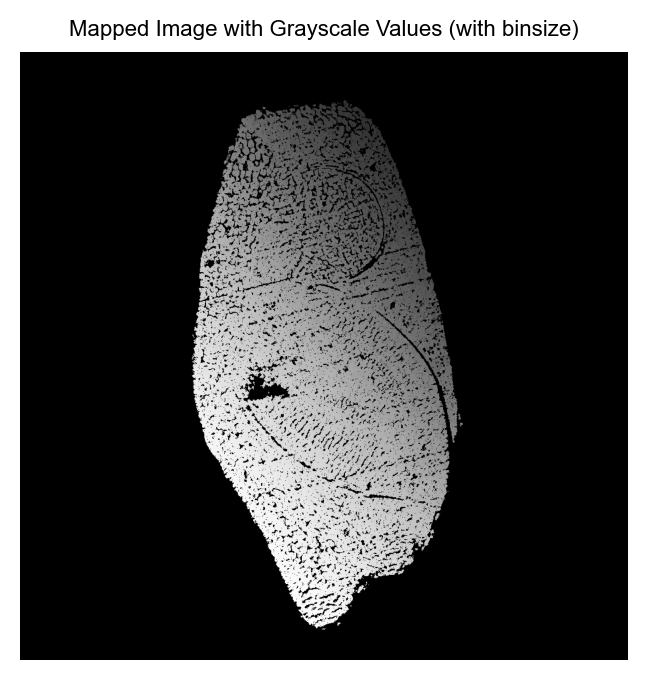

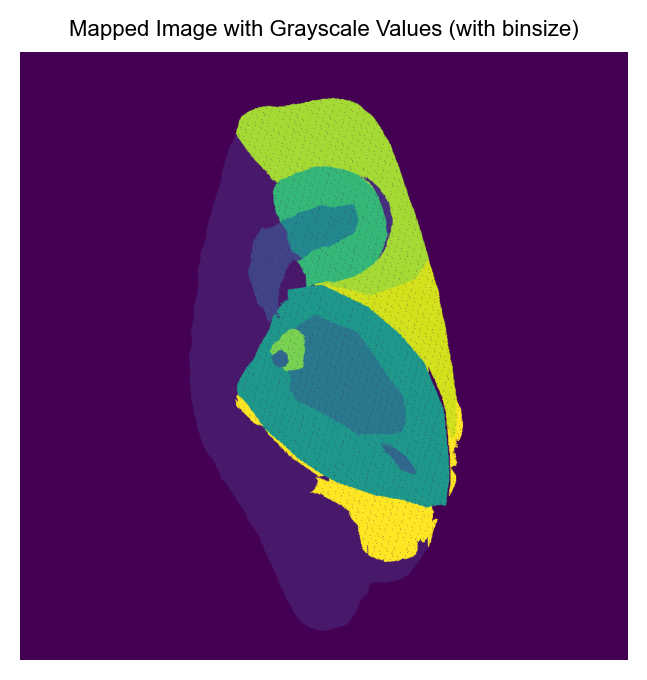

In [11]:
x_bin1, y_bin1, bin1_img = save_image(int(min_value+50), radii_ST_bin1_scale, angles_ST_bin1_scale, rotated_grayscale_origin, f'{work_path}ST_bin1.png', binsize=0, normalize=False)
coor['x_bin1'] = x_bin1
coor['y_bin1'] = y_bin1
x_ST_slide, y_ST_slide, ST_slide_img = save_image(int(min_value+50), radii_ST_slide_scale, angles_ST_slide_scale, value_ST_slide, f'{work_path}ST_slide.png', binsize=0, normalize=False)
x_3D_origin, y_3D_origin, origin_img = save_image(int(min_value+50), radii_3D_origin_scale, alpha_3D_origin_scale, rotated_grayscale_origin, f'{work_path}3D_origin.png', binsize=1, normalize=False)
x_3D_cellseg, y_3D_cellseg, cellseg_img = save_image(int(min_value+50), radii_3D_cellseg_scale, alpha_3D_cellseg_scale, rotated_grayscale_cellseg, f'{work_path}3D_cellseg.png', binsize=0, normalize=False)

x_3D_ts, y_3D_ts, ts_img = save_image_colorful(int(min_value+50), radii_3D_ts_scale, alpha_3D_ts_scale, rotated_grayscale_ts, f'{work_path}3D_ts.png', binsize=0, normalize=False)

#获得4张图
#ST_bin1.png
#ST_slide.png
#3D_origin.png
#3D_cellseg.png
#3D_ts.png

ST_bin1对齐ST_slide

In [12]:
# ST_bin1_ST_slide_alighment
target_img_path = f'{work_path}ST_slide.png ' 
source_img_path = f'{work_path}ST_bin1.png' 
aligned_path = f'{work_path}ST_bin1_ST_slide_alighment.csv'
ST_bin1_ST_slide_reflection_path = f'{work_path}ST_bin1_ST_slide_reflection.csv'

In [ ]:
align_manually(target_img_path, source_img_path, aligned_path, ST_bin1_ST_slide_reflection_path)

Instructions:
 - W/S: Scale up/down
 - A/D: Rotate counterclockwise/clockwise
 - I/K/J/L: Move image (translate)
 - X: Flip horizontally
 - Y: Flip vertically
 - C: Crop to region of interest
 - Q: Quit and save the result
Aligned pixel values and coordinates saved to G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_1/ST_bin1_ST_slide_alighment.csv
坐标映射已保存至 G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_1/ST_bin1_ST_slide_reflection.csv


In [13]:
# 获得对齐前后的对应关系
ST_bin1_ST_slide_reflection_path = f'{work_path}ST_bin1_ST_slide_reflection.csv'
ST_bin1_ST_slide_reflection = pd.read_csv(ST_bin1_ST_slide_reflection_path)
# 合并 reflection 和 filtered_df，基于 Original_X 和 Original_Y 和 x_ST, y_ST
coor = coor.merge(
    ST_bin1_ST_slide_reflection[['Original_X', 'Original_Y', 'Transformed_X', 'Transformed_Y']],
    left_on=['x_bin1', 'y_bin1'],
    right_on=['Original_X', 'Original_Y'],
    how='left'
)

3D_origin对齐ST_slide

In [14]:
# 3D_origin_ST_slide_alighment
target_img_path = f'{work_path}ST_slide.png ' 
source_img_path = f'{work_path}3D_origin.png' 
aligned_path = f'{work_path}3D_origin_ST_slide_alighment.csv'
thD_origin_ST_slide_reflection_path = f'{work_path}3D_origin_ST_slide_reflection.csv'

In [ ]:
align_manually(target_img_path, source_img_path, aligned_path, thD_origin_ST_slide_reflection_path)

Instructions:
 - W/S: Scale up/down
 - A/D: Rotate counterclockwise/clockwise
 - I/K/J/L: Move image (translate)
 - X: Flip horizontally
 - Y: Flip vertically
 - C: Crop to region of interest
 - Q: Quit and save the result
Aligned pixel values and coordinates saved to G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_1/3D_origin_ST_slide_alighment.csv
坐标映射已保存至 G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_1/3D_origin_ST_slide_reflection.csv


3D_cellseg对齐ST_slide

In [15]:
thD_origin_ST_slide_reflection_path = f'{work_path}3D_origin_ST_slide_reflection.csv'
output_img_path = f'{work_path}3D_cellseg_ST_slide_alighment.png'  # 保存变换后的图片路径

thD_cellseg_img = apply_transformation_and_save(cellseg_img, thD_origin_ST_slide_reflection_path, output_img_path)
# 保存像素值和坐标
aligned_coordinates = []
aligned_pixel_values = []

# 遍历对齐后的图像获取像素值和对应坐标
for y in range(thD_cellseg_img.shape[0]):
    for x in range(thD_cellseg_img.shape[1]):
        # 恢复坐标到原始比例
        original_x = int(x)
        original_y = int(y)
        aligned_coordinates.append((original_x, original_y))
        aligned_pixel_values.append(thD_cellseg_img[y, x])

# 保存为 DataFrame 并写入 CSV
df = pd.DataFrame({
    'X_Coordinate': [coord[0] for coord in aligned_coordinates],
    'Y_Coordinate': [coord[1] for coord in aligned_coordinates],
    'Pixel_Value': aligned_pixel_values
})

df.to_csv(f'{work_path}3D_cellseg_ST_slide_alighment.csv', index=False)

Transformed image saved to G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_2/3D_cellseg_ST_slide_alighment.png


In [16]:
thD_origin_ST_slide_reflection_path = f'{work_path}3D_origin_ST_slide_reflection.csv'
output_img_path = f'{work_path}3D_ts_ST_slide_alighment.png'  # 保存变换后的图片路径

thD_ts_img = apply_transformation_and_save(ts_img, thD_origin_ST_slide_reflection_path, output_img_path)
# 保存像素值和坐标
aligned_coordinates = []
aligned_pixel_values = []

# 遍历对齐后的图像获取像素值和对应坐标
for y in range(thD_ts_img.shape[0]):
    for x in range(thD_ts_img.shape[1]):
        # 恢复坐标到原始比例
        original_x = int(x)
        original_y = int(y)
        aligned_coordinates.append((original_x, original_y))
        aligned_pixel_values.append(thD_ts_img[y, x])

# 保存为 DataFrame 并写入 CSV
df = pd.DataFrame({
    'X_Coordinate': [coord[0] for coord in aligned_coordinates],
    'Y_Coordinate': [coord[1] for coord in aligned_coordinates],
    'Pixel_Value': aligned_pixel_values
})

df.to_csv(f'{work_path}3D_ts_ST_slide_alighment.csv', index=False)

Transformed image saved to G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_2/3D_ts_ST_slide_alighment.png


保存人工对齐后的图片

Image size: 1072x1072


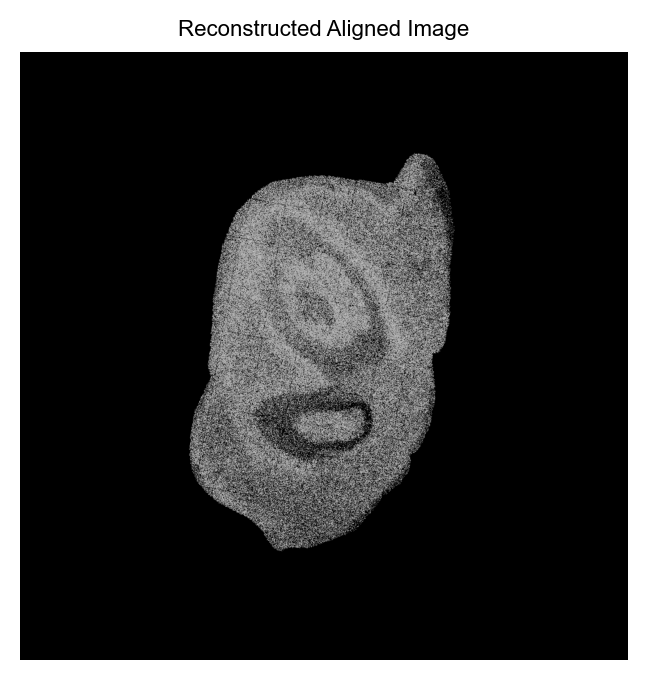

Image size: 1072x1072


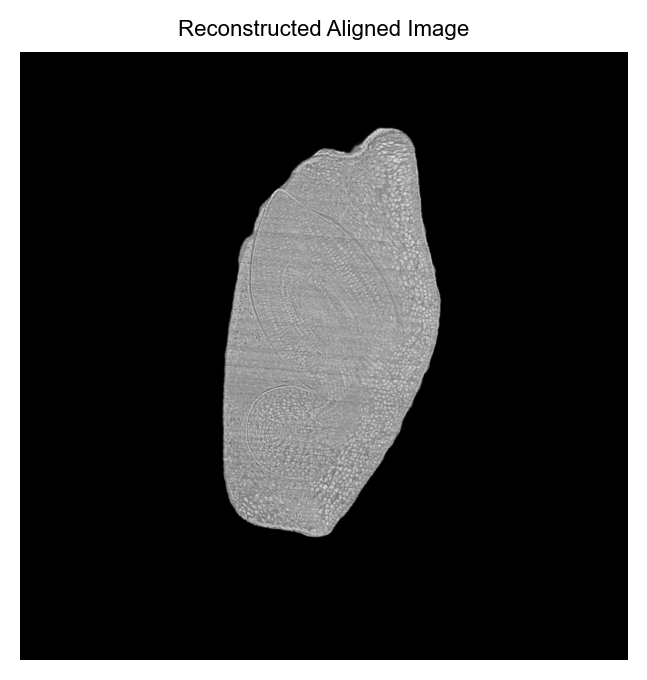

Image size: 1072x1072


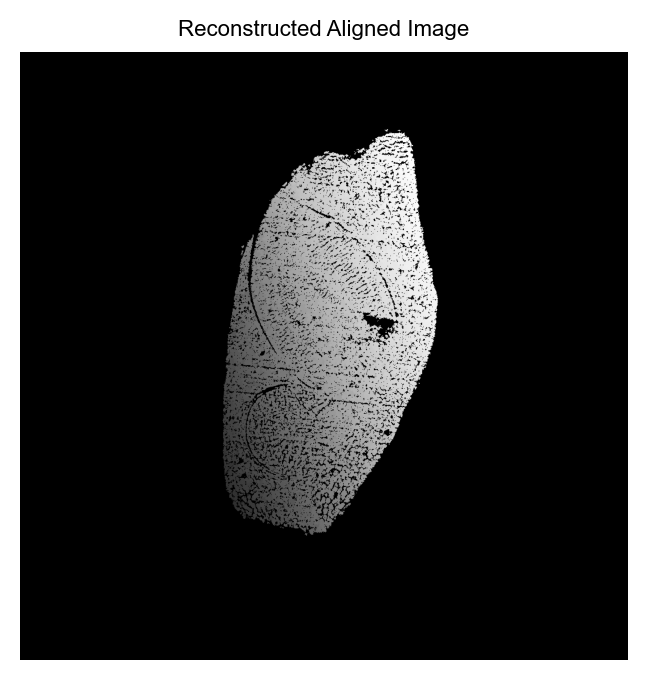

Image size: 1072x1072


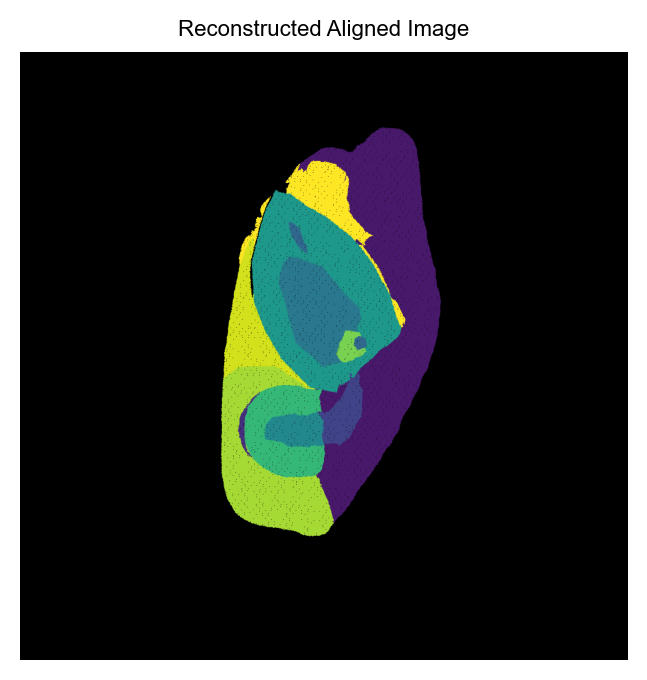

In [17]:
aligned_path = f'{work_path}ST_bin1_ST_slide_alighment.csv' 
output_image_path = f'{work_path}ST_bin1_ST_slide_alighment.png'  
x_ST_bin1, y_ST_bin1, pixel_ST_bin1 = visualize_aligned_image(aligned_path, output_image_path)

aligned_path = f'{work_path}3D_origin_ST_slide_alighment.csv' 
output_image_path = f'{work_path}3D_origin_ST_slide_alighment.png'  
x_3D_origin_alighed, y_3D_origin_alighed, pixel_3D_origin = visualize_aligned_image(aligned_path, output_image_path)

aligned_path = f'{work_path}3D_cellseg_ST_slide_alighment.csv' 
output_image_path = f'{work_path}3D_cellseg_ST_slide_alighment.png'  
x_3D_cellseg_alighed, y_3D_cellseg_alighed, pixel_3D_cellseg = visualize_aligned_image(aligned_path, output_image_path)

aligned_path = f'{work_path}3D_ts_ST_slide_alighment.csv' 
output_image_path = f'{work_path}3D_ts_ST_slide_alighment.png'  

x_3D_ts_alighed, y_3D_ts_alighed, pixel_3D_ts = visualize_aligned_image_colorful(aligned_path, output_image_path)

In [18]:
output_image_path = f'{work_path}ST_bin1_ST_slide_alighment_fill.png'
x_ST_bin1_fill, y_ST_bin1_fill, pixel_ST_bin1_fill = get_coordinates_and_pixel_values(output_image_path)

自动选点

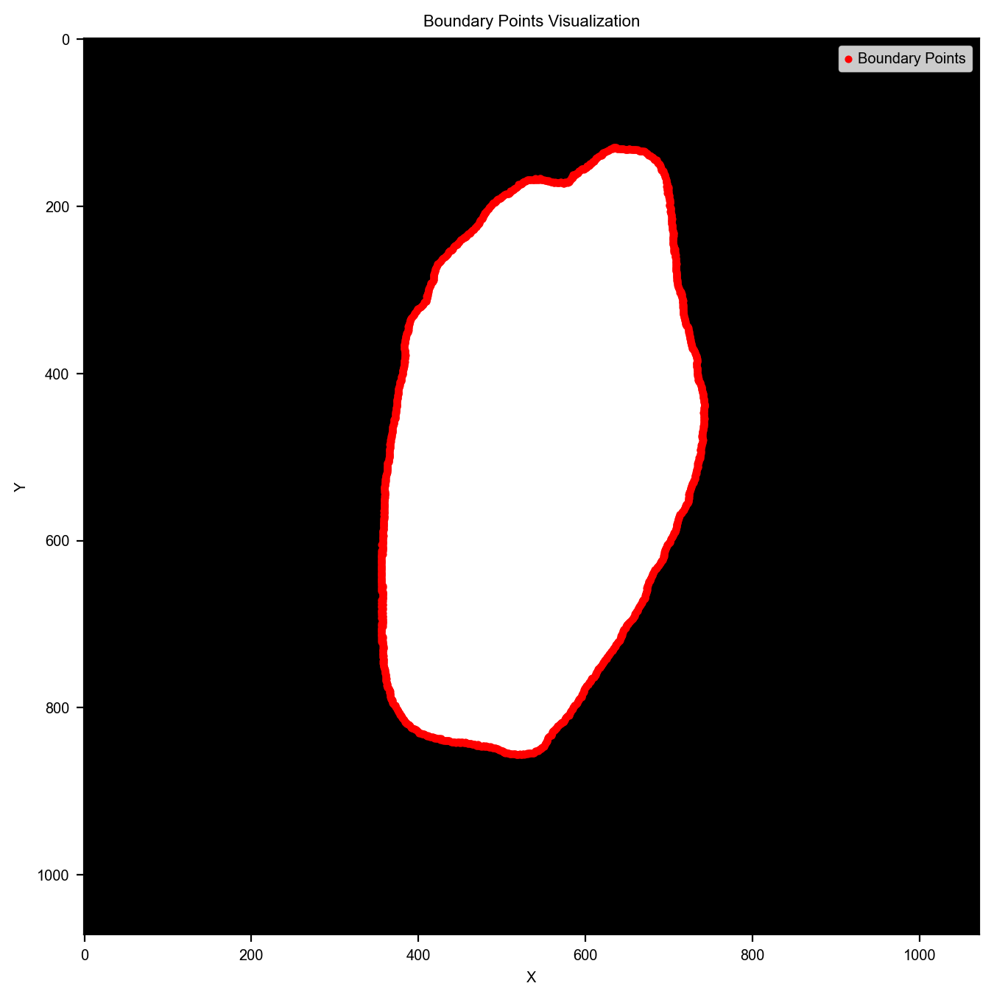

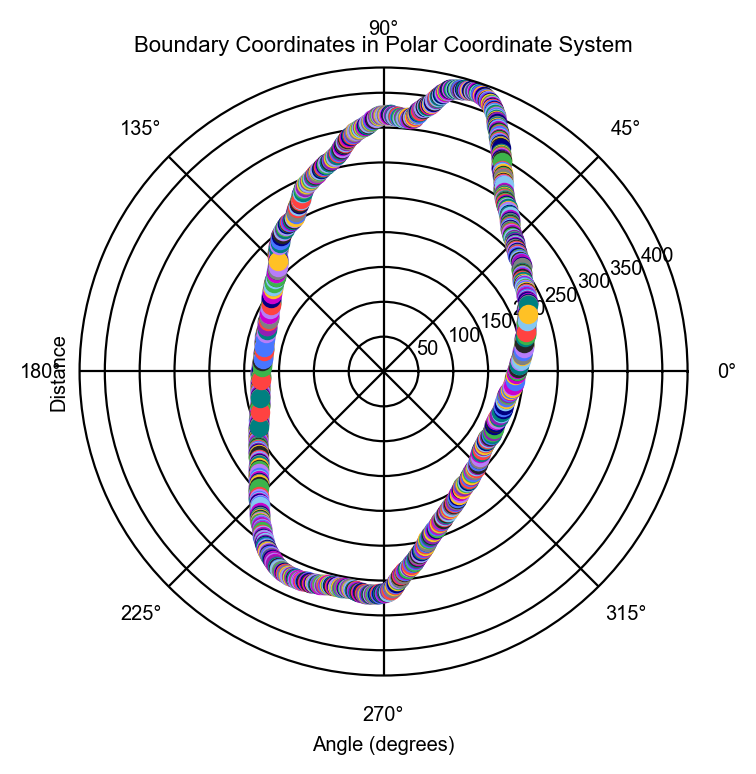

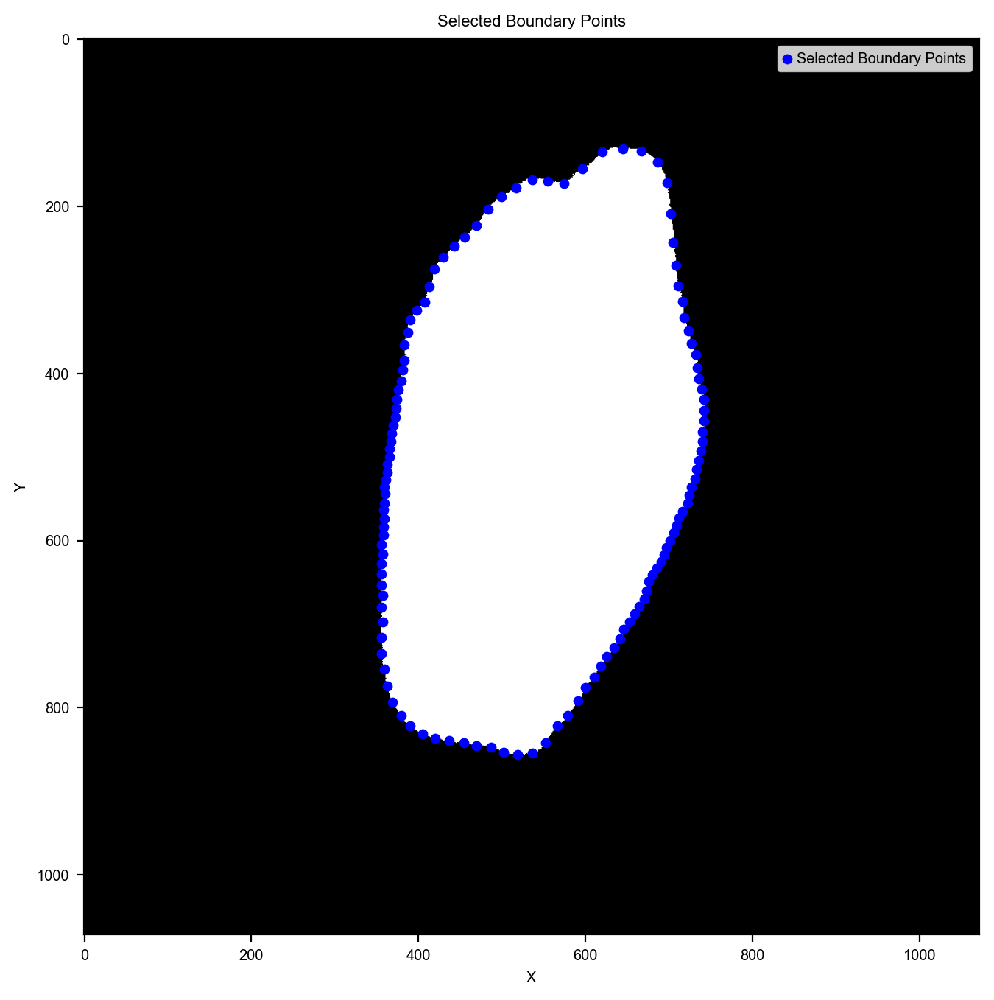

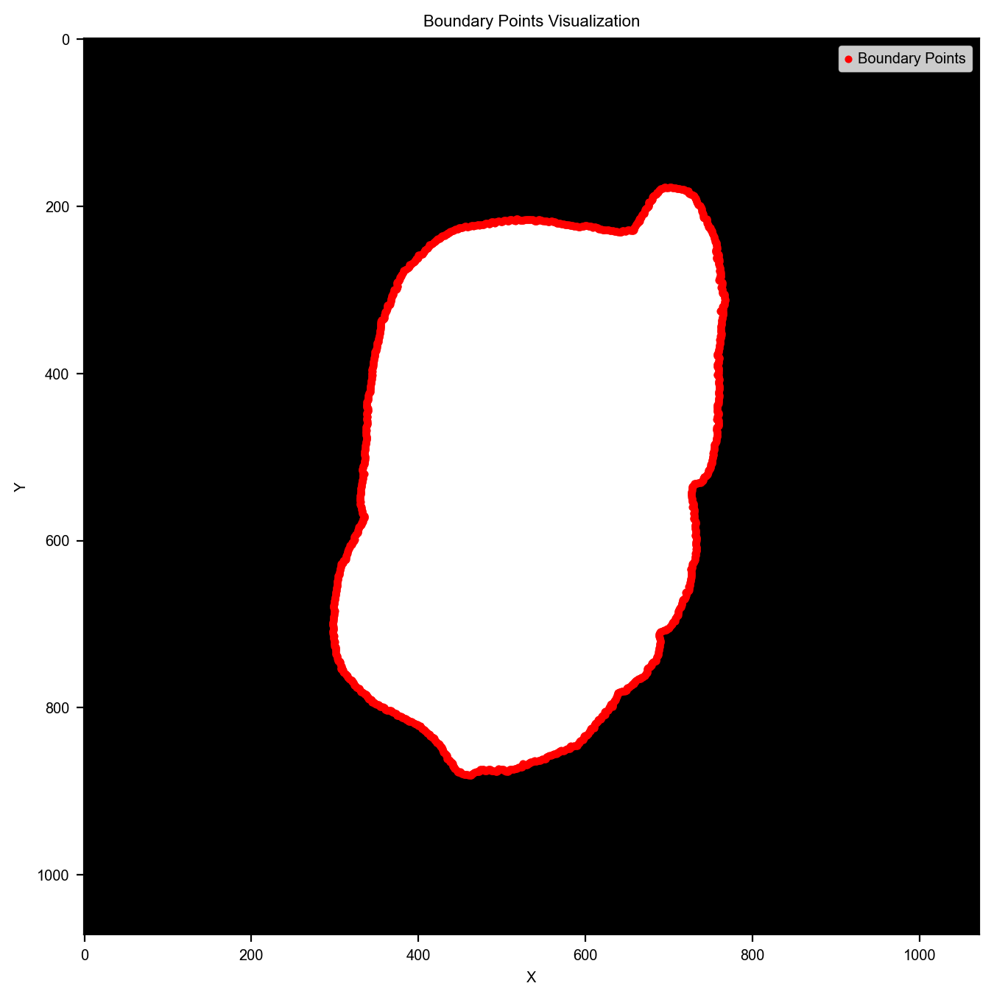

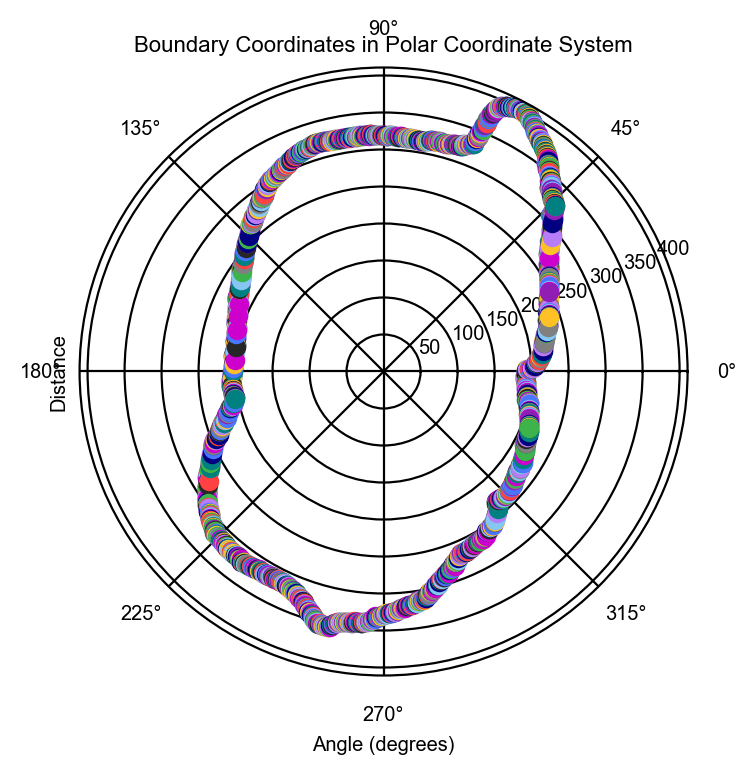

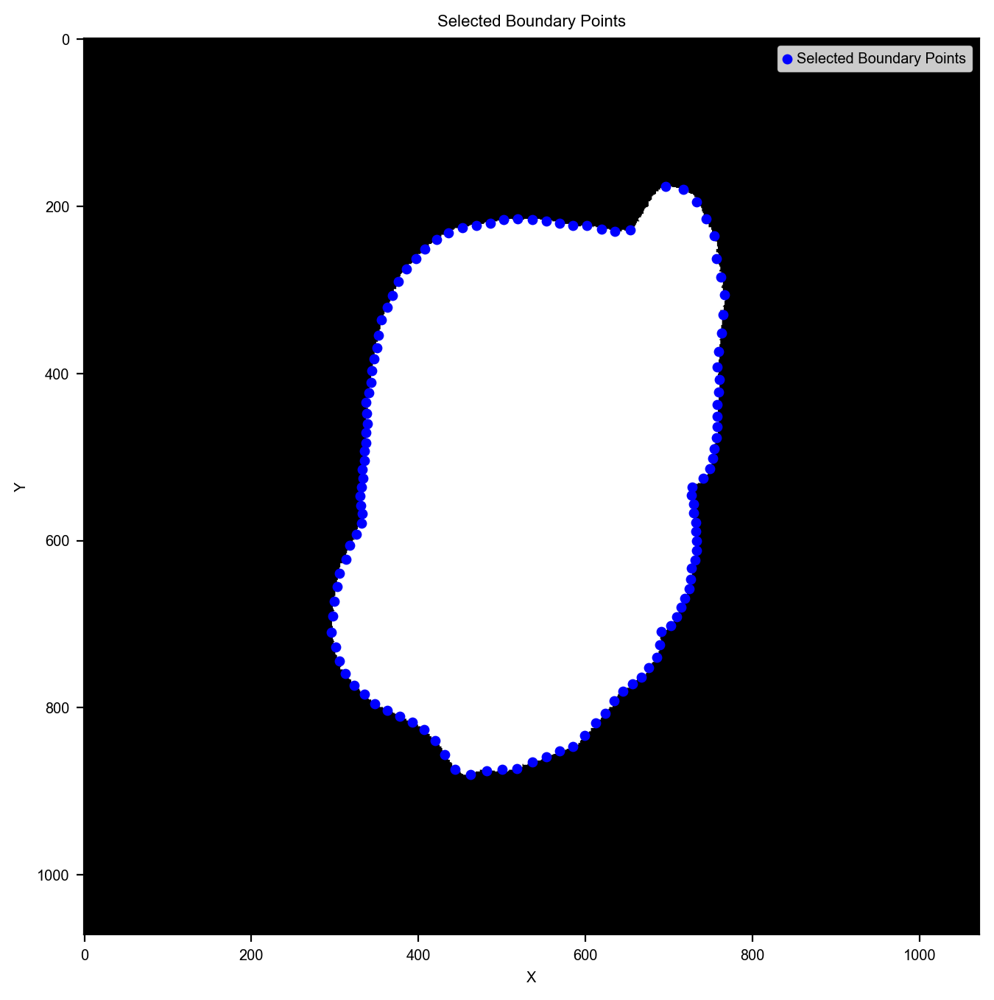

In [19]:
selected_points_3D = Feature_Point_Selection_Auto(x_3D_origin_alighed, y_3D_origin_alighed, pixel_3D_origin, work_path, '3D',angle_step=3, expand_step=0,center = int(min_value+50))
selected_points_ST = Feature_Point_Selection_Auto(x_ST_bin1_fill, y_ST_bin1_fill, pixel_ST_bin1_fill, work_path, 'ST',angle_step=3, expand_step=0,center = int(min_value+50))

手动选点

In [ ]:
# 用于存储标注点的列表
src_points = []
dst_points = []

# 当前标注的是源图像还是目标图像
is_marking_src = True  # True表示标注源图像，False表示标注目标图像

# 调用函数进行标注
manual_ST_path = f'{work_path}ST-manual_label.csv'
manual_3D_path = f'{work_path}3D-manual_label.csv'
file_name_3d = '3D_ts'
file_name_st = 'ST_slide'
src_img_path = f'{work_path}{file_name_st}.png'
dst_img_path = f'{work_path}{file_name_3d}_ST_slide_alighment.png'
Feature_Point_Selection_Manuual(manual_ST_path, manual_3D_path, src_img_path, dst_img_path)

标注完成，源点和目标点已保存到 CSV 文件。


合并点

In [25]:
merge_csv_files_by_prefix(work_path, 'ST-', 'ST.csv')
merge_csv_files_by_prefix(work_path, '3D-', '3D.csv')

数据已保存为: G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_2/ST.csv
数据已保存为: G:/snm/embryo3D/24H_AntherS1_2.07um_recon_Export/zoo/3DRiceSeedPRJT/data/ST-bin1/HAI24_2/3D.csv


可视化标注结果

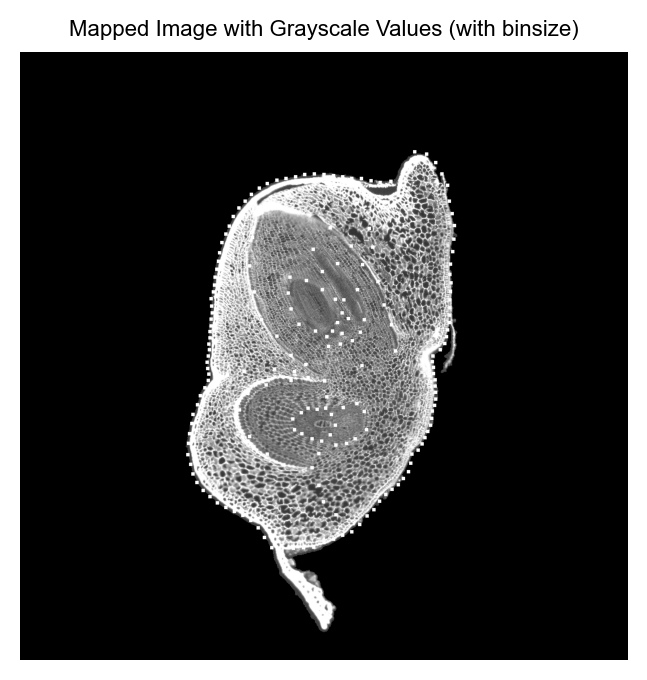

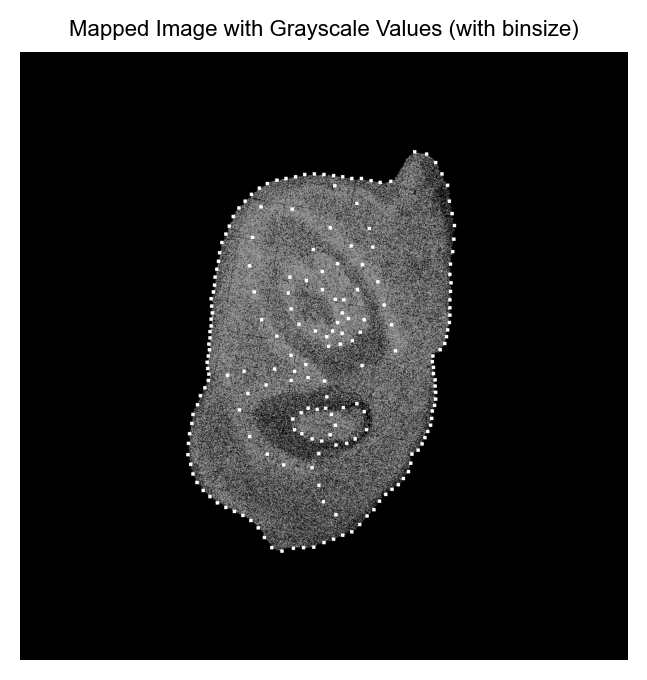

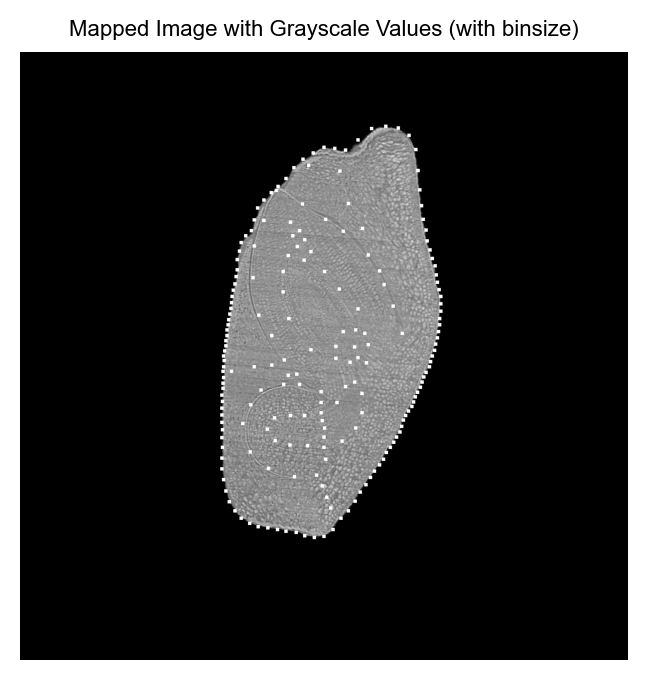

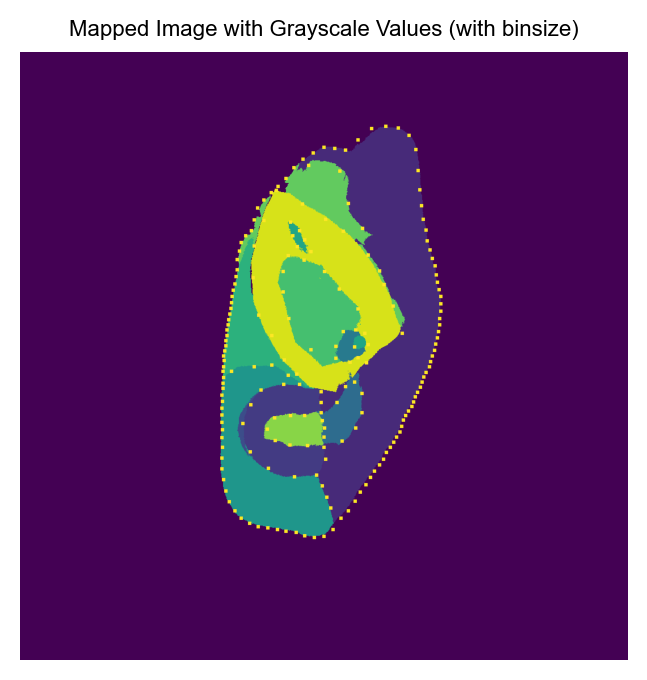

In [26]:
generate_mapped_image_with_boundary(x_ST_slide, y_ST_slide, value_ST_slide, int(min_value+50), f'{work_path}ST.csv' )
generate_mapped_image_with_boundary(x_ST_bin1, y_ST_bin1, pixel_ST_bin1, int(min_value+50), f'{work_path}ST.csv' )
generate_mapped_image_with_boundary(x_3D_origin_alighed, y_3D_origin_alighed, pixel_3D_origin, int(min_value+50), f'{work_path}3D.csv' )
generate_mapped_image_with_boundary_colorful(x_3D_ts_alighed, y_3D_ts_alighed, pixel_3D_ts, int(min_value+50), f'{work_path}3D.csv' )

TPS变换

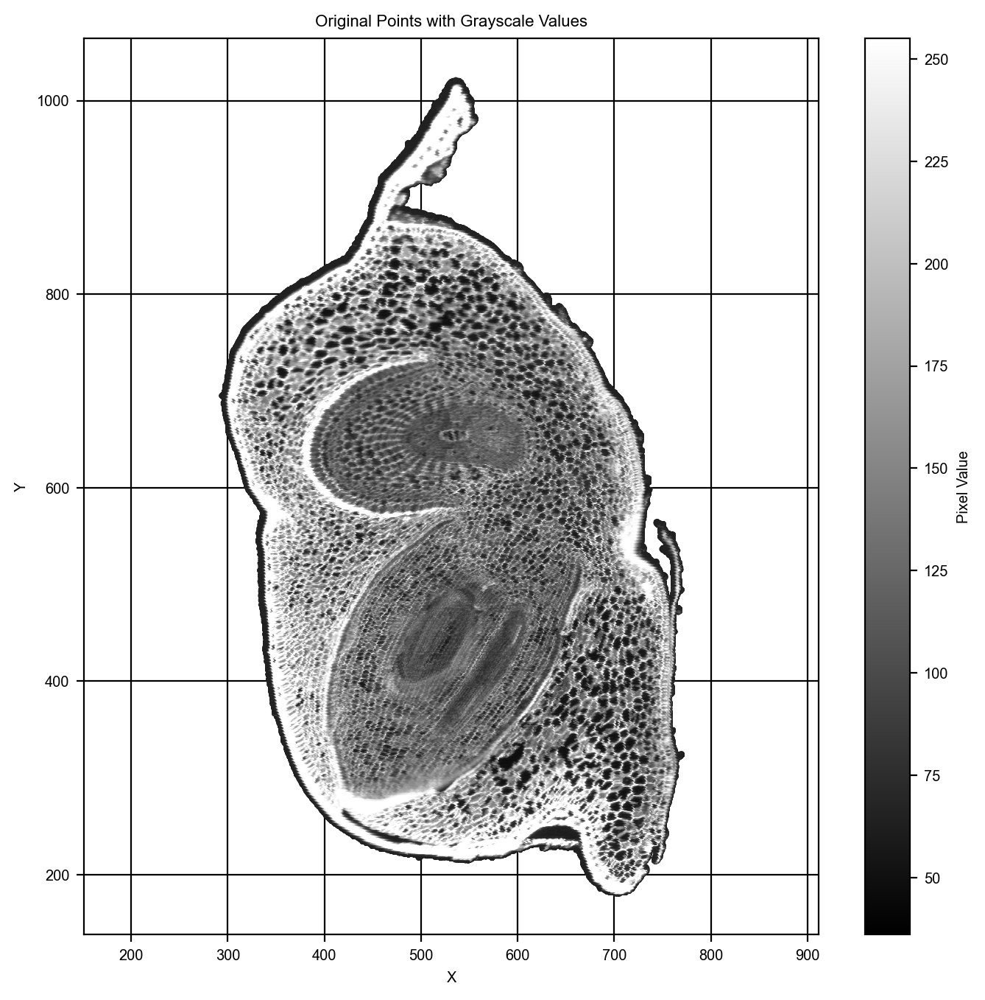

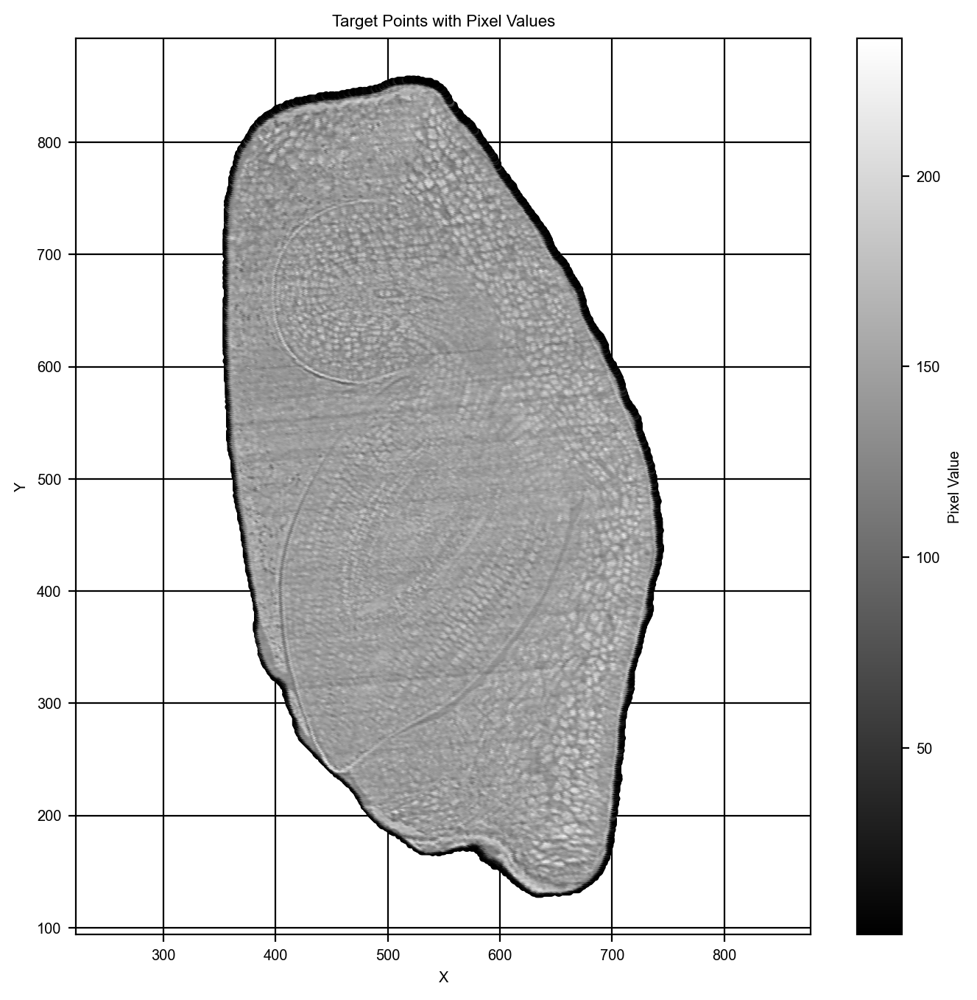

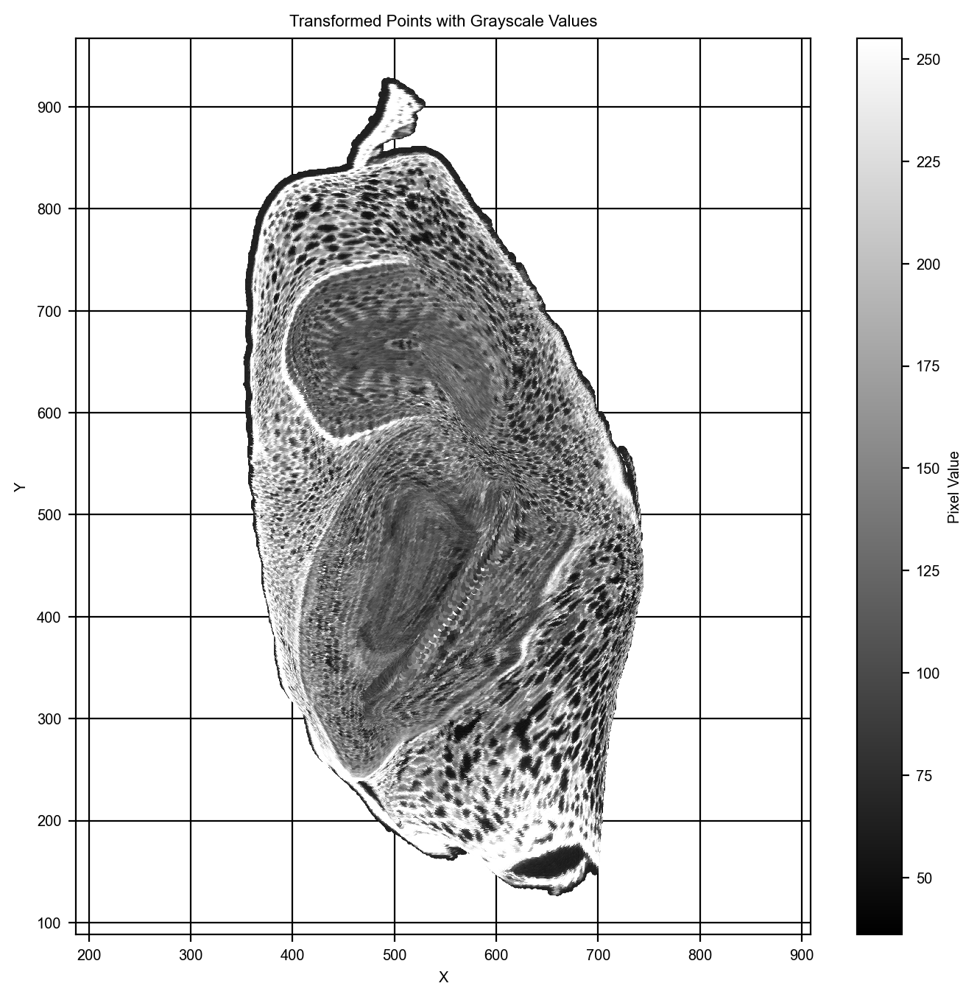

In [27]:
# 设置标记点CSV文件路径
src_csv_path = f'{work_path}ST.csv'  # 源点标记点CSV文件
dst_csv_path = f'{work_path}3D.csv'  # 目标点标记点CSV文件

# x_ST_slide, y_ST_slide, value_ST_slide

x_src = x_ST_slide
y_src = y_ST_slide
pixel_src = value_ST_slide

def tps_transformed_quick(x1, y1, grayscale_3D, x2, y2, pixel_values, src_csv, dst_csv):
    # 转换笛卡尔坐标为点集
    src_coordinates = np.column_stack((x1, y1))

    # 读取标记点
    src_points = read_csv_points(src_csv)  # 源图标记点
    dst_points = read_csv_points(dst_csv)  # 目标图标记点

    # 对原始点集进行TPS变换
    transformed_coordinates = tps_transform(src_points, dst_points, src_coordinates)

    # 分别可视化原始点、目标点和变换后的点
    plot_single_points(x1, y1, grayscale_3D, "Original Points with Grayscale Values", cmap='gray', s= 3)
    plot_single_points(x2, y2, pixel_values, "Target Points with Pixel Values", cmap='gray', s= 10)
    plot_single_points(transformed_coordinates[:, 0], transformed_coordinates[:, 1], grayscale_3D,
                        "Transformed Points with Grayscale Values", cmap='gray', s= 3)
    return transformed_coordinates

transformed_coordinates = tps_transformed_quick(x_src, y_src, pixel_src, x_3D_origin_alighed, y_3D_origin_alighed, pixel_3D_origin,  src_csv_path, dst_csv_path)

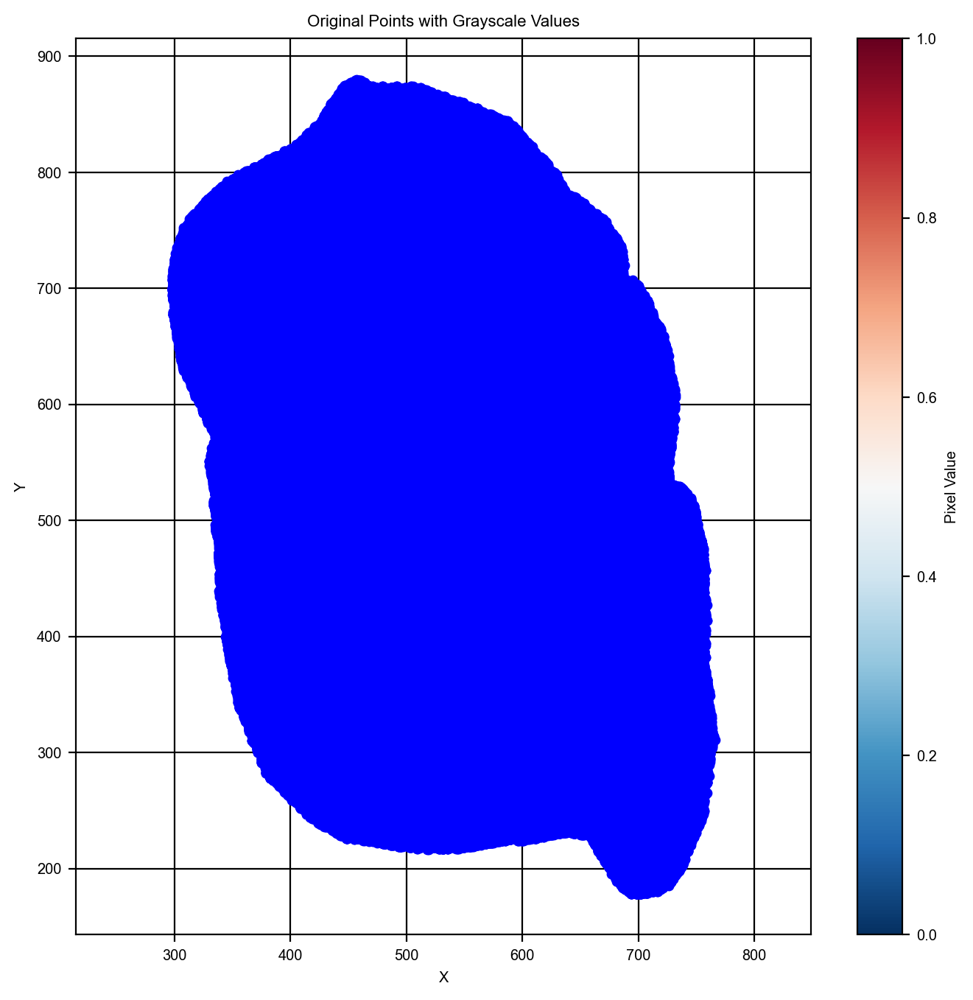

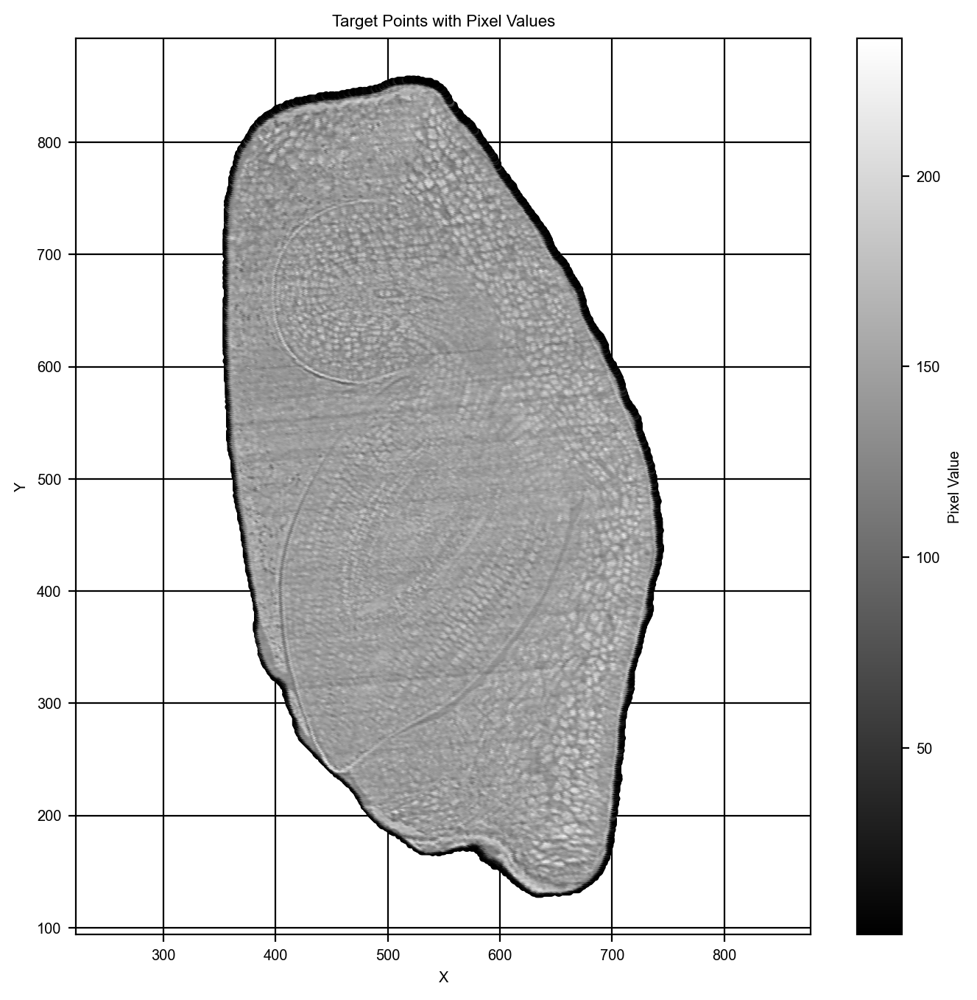

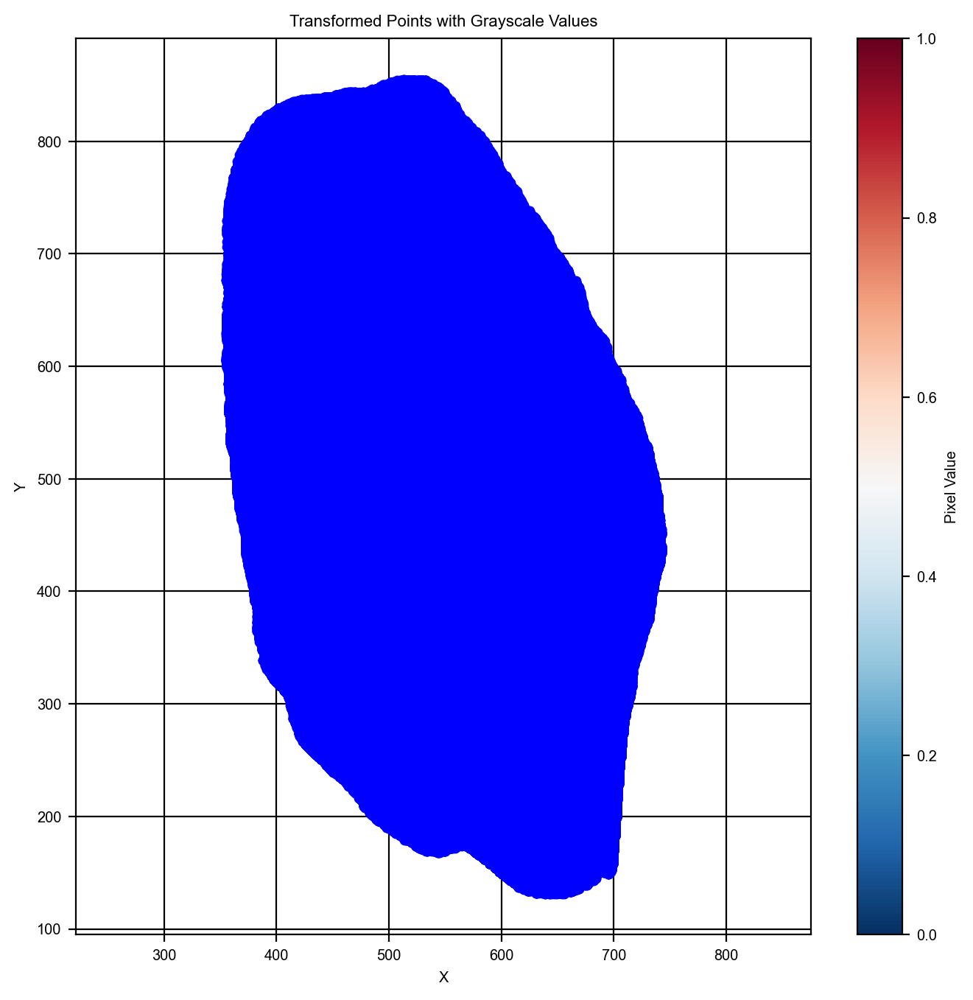

         TPS_x  TPS_y
0          426    619
1          630    666
2          395    359
3          613    694
4          459    373
...        ...    ...
1121647    569    333
1121648    699    163
1121649    500    330
1121650    369    520
1121651    615    565

[1121652 rows x 2 columns]


In [28]:
# 设置标记点CSV文件路径
src_csv_path = f'{work_path}ST.csv'  # 源点标记点CSV文件
dst_csv_path = f'{work_path}3D.csv'  # 目标点标记点CSV文件

x_src = coor['Transformed_X']
y_src = coor['Transformed_Y']
# pixel_src = coor['pixel_values']

# 执行TPS变换并可视化
transformed_coordinates = tps_transformed(x_src, y_src, 'blue', x_3D_origin_alighed, y_3D_origin_alighed, pixel_3D_origin,  src_csv_path, dst_csv_path)

coor['TPS_x'] = transformed_coordinates[:, 0]  # 添加 TPS_x 列
coor['TPS_y'] = transformed_coordinates[:, 1]  # 添加 TPS_y 列
coor['TPS_x'] = coor['TPS_x'].apply(lambda x: np.nan if pd.isna(x) else round(x))
coor['TPS_y'] = coor['TPS_y'].apply(lambda x: np.nan if pd.isna(x) else round(x))
print(coor[['TPS_x', 'TPS_y']])

ST_bin1 3D_cellseg对应关系

In [29]:
coor_matched = process_matching_and_save_with_cuda(coor, x_3D_cellseg_alighed, y_3D_cellseg_alighed, pixel_3D_cellseg)
coor_matched['ST_bin1_barcode'] = coor_matched['x'].astype(str) + '_' + coor_matched['y'].astype(str) + '_'+ batch
print(coor_matched.head())

Processing Matches with CUDA: 100%|██████████| 113/113 [06:52<00:00,  3.65s/batch]


       x      y     radii_ST  angles_ST  radii_ST_bin1_scale  \
0  15269   9451   622.166982  -1.070482           167.811080   
1  14332   9085  1113.246891  -2.181676           300.265312   
2  15808  10532   993.806912   0.568567           268.049922   
3  14445   8986  1139.357422  -2.050217           307.307853   
4  15335  10346   504.669680   0.763870           136.119670   

   angles_ST_bin1_scale  x_bin1  y_bin1  Original_X  Original_Y  \
0              2.052547     458     684         458         684   
1              0.941352     712     778         712         778   
2              3.691596     307     395         307         395   
3              1.072812     682     805         682         805   
4              3.886899     435     443         435         443   

   Transformed_X  Transformed_Y  TPS_x  TPS_y  3D_cellbarcode  \
0            447            604    426    619         56428.0   
1            631            716    630    666        104582.0   
2            373 

In [30]:
ST_bin1_path = f'{work_path}{batch}_bin1.gem'
ST_bin1 = pd.read_csv(ST_bin1_path, sep='\t')
ST_bin1['ST_bin1_barcode'] = ST_bin1['x'].astype(str) + '_' + ST_bin1['y'].astype(str) + '_'+ batch
# unique_ST_bin1 = ST_bin1[['x', 'y']].drop_duplicates()
coor_matched = coor_matched[['3D_cellbarcode', 'ST_bin1_barcode', 'x', 'y', 'TPS_x', 'TPS_y']]
merged_df = pd.merge(ST_bin1, coor_matched[['3D_cellbarcode', 'ST_bin1_barcode', 'TPS_x', 'TPS_y']], left_on='ST_bin1_barcode', right_on='ST_bin1_barcode', how='left')

In [31]:
import pandas as pd

# Ensure both columns are of the same type (convert to string or numeric as appropriate)
merged_df['3D_cellbarcode'] = merged_df['3D_cellbarcode'].astype(str)
Cellseg_barcodeCount_selectedSlide['cellseg_barcode'] = Cellseg_barcodeCount_selectedSlide['cellseg_barcode'].astype(str)

# Merge the two dataframes based on '3D_cellbarcode' and 'cellseg_barcode'
merged_df = pd.merge(merged_df, 
                     Cellseg_barcodeCount_selectedSlide[['cellseg_barcode', 'ratio']], 
                     left_on='3D_cellbarcode', 
                     right_on='cellseg_barcode', 
                     how='left')

# Drop the extra 'cellseg_barcode' column
merged_df.drop(columns=['cellseg_barcode'], inplace=True)

In [32]:
merged_df_cleaned = merged_df.dropna(subset=['ratio'])
merged_df_cleaned

,geneID,x,y,MIDCounts,ST_bin1_barcode,3D_cellbarcode,TPS_x,TPS_y,ratio
0,ENSRNA049442424,15269,9451,1,15269_9451_HAI24_2,56428.0,426,619,3.0
1,ENSRNA049445231,14332,9085,1,14332_9085_HAI24_2,104582.0,630,666,12.0
2,ENSRNA049445269,15808,10532,1,15808_10532_HAI24_2,74608.0,395,359,26.0
3,ENSRNA049446332,14445,8986,1,14445_8986_HAI24_2,101218.0,613,694,6.0
4,ENSRNA049448834,15335,10346,1,15335_10346_HAI24_2,89890.0,459,373,6.0
...,...,...,...,...,...,...,...,...,...
1426149,gene-rps7-3,14597,10877,1,14597_10877_HAI24_2,131896.0,616,290,8.0
1426152,gene-rps7-3,15258,10341,1,15258_10341_HAI24_2,91405.0,478,381,8.0
1426153,gene-rps7-3,14798,10460,2,14798_10460_HAI24_2,104401.0,500,330,5.0
1426154,gene-rps7-3,15782,9753,1,15782_9753_HAI24_2,49577.0,369,520,16.0


In [33]:
merged_df_cleaned['MIDCounts_scale'] = merged_df_cleaned['MIDCounts'] * merged_df_cleaned['ratio']
print(merged_df_cleaned.head())

            geneID      x      y  MIDCounts      ST_bin1_barcode  \
0  ENSRNA049442424  15269   9451          1   15269_9451_HAI24_2   
1  ENSRNA049445231  14332   9085          1   14332_9085_HAI24_2   
2  ENSRNA049445269  15808  10532          1  15808_10532_HAI24_2   
3  ENSRNA049446332  14445   8986          1   14445_8986_HAI24_2   
4  ENSRNA049448834  15335  10346          1  15335_10346_HAI24_2   

  3D_cellbarcode  TPS_x  TPS_y  ratio  MIDCounts_scale  
0        56428.0    426    619    3.0              3.0  
1       104582.0    630    666   12.0             12.0  
2        74608.0    395    359   26.0             26.0  
3       101218.0    613    694    6.0              6.0  
4        89890.0    459    373    6.0              6.0  


In [34]:
# 对于每个 3D_cellbarcode，合并 ST_bin1_barcode 的基因表达值（通常是求和或平均）
# 假设 MIDCounts 是基因表达值
gene_expression_matrix = merged_df_cleaned.groupby(['geneID', '3D_cellbarcode'])['MIDCounts'].sum().unstack(fill_value=0)
# gene_expression_matrix
gene_expression_matrix_scale = merged_df_cleaned.groupby(['geneID', '3D_cellbarcode'])['MIDCounts_scale'].sum().unstack(fill_value=0)
# gene_expression_matrix_scale

In [35]:
counts = gene_expression_matrix
adata = ad.AnnData(X=counts.T)
counts_scale = gene_expression_matrix_scale
adata_scale = ad.AnnData(X=counts_scale.T)

In [36]:
counts.to_csv(f'{work_path}{batch}_bin1_counts.csv', index=True)
adata.write(f'{work_path}{batch}_bin1_adata.h5ad')
counts_scale.to_csv(f'{work_path}{batch}_bin1_counts_VolumeScale.csv', index=True)
adata_scale.write(f'{work_path}{batch}_bin1_adata_VolumeScale.h5ad')

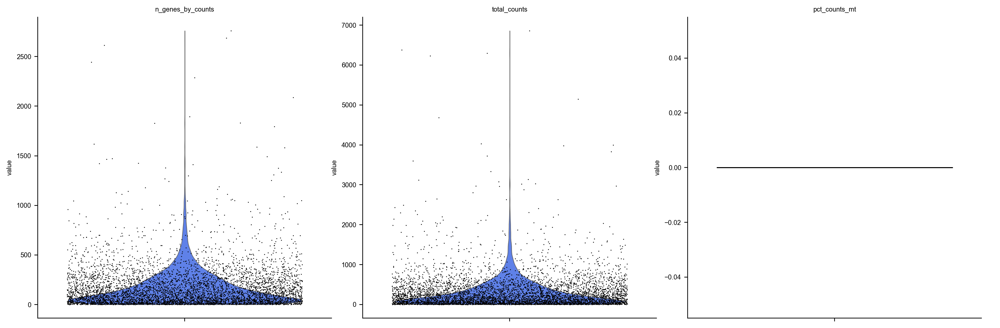

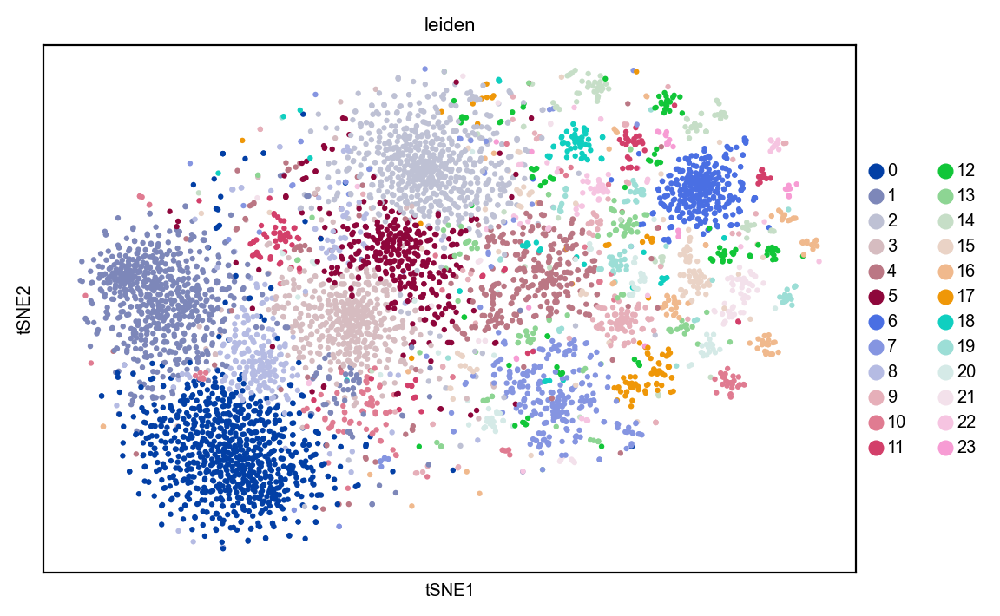

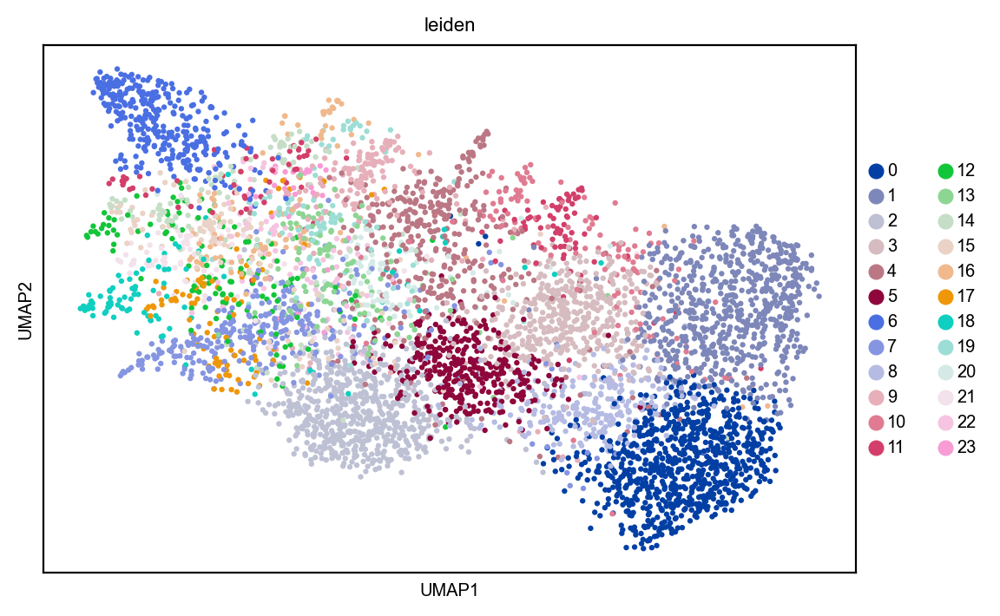

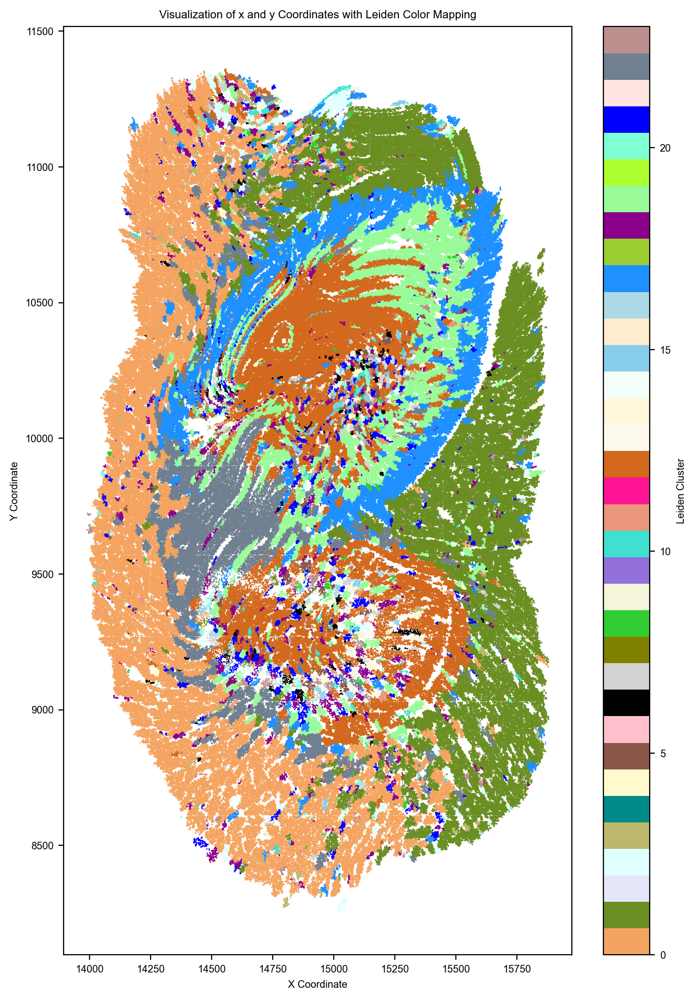

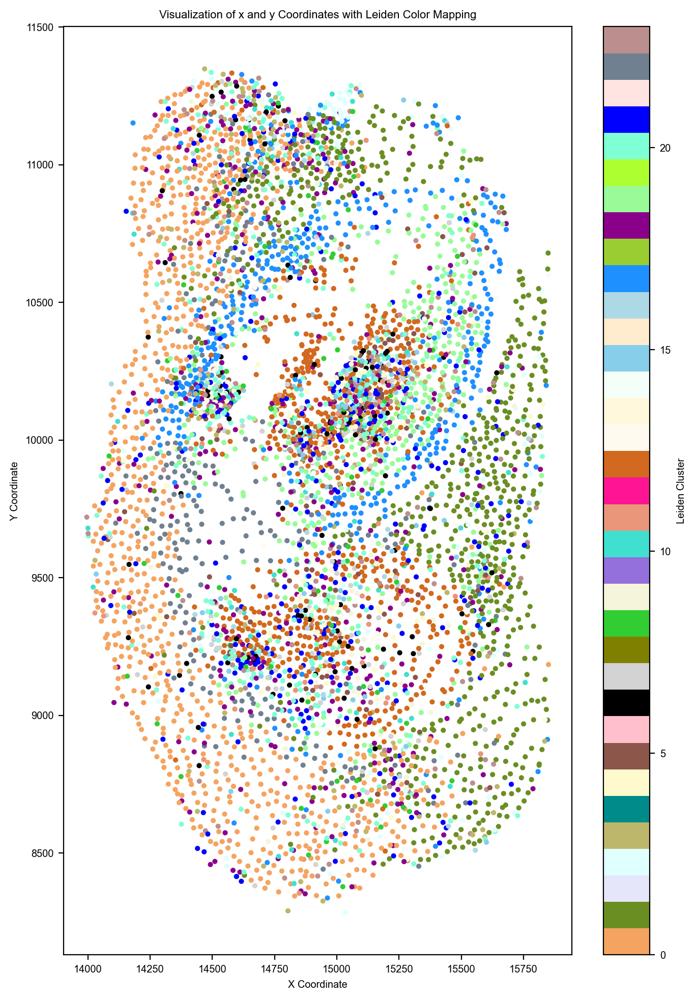

In [37]:
import matplotlib.colors as mcolors

# Assuming merged_df and 'leiden_numeric' are already defined
# Manually selecting 40 distinct colors from matplotlib
colors = list(mcolors.TABLEAU_COLORS.values()) + list(mcolors.CSS4_COLORS.values())
# Randomly shuffle or select 40 colors
np.random.shuffle(colors)
selected_colors = colors[:35]

counts = gene_expression_matrix
adata = ad.AnnData(X=counts.T)

# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]")
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

sc.pp.filter_cells(adata, min_genes=0)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
sc.pp.filter_cells(adata, max_genes=3000)
sc.pp.filter_genes(adata, min_cells=1)

sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

# sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

# Saving count data
adata.layers["counts"] = adata.X.copy()
# Normalizing to median total counts
sc.pp.normalize_total(adata)
# Logarithmize the data
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, n_top_genes=30000)
# sc.pl.highly_variable_genes(adata)

sc.tl.pca(adata)
# sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)
# sc.pl.pca(
#     adata,
#     dimensions=[(0, 1), (2, 3), (0, 1), (2, 3)],
#     ncols=2,
#     size=2,
# )

sc.pp.neighbors(adata)
# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(adata, flavor="leidenalg", resolution=1.7, n_iterations=2)
sc.tl.tsne(adata)
sc.pl.tsne(adata, color=["leiden"])
sc.tl.umap(adata)
sc.pl.umap(adata, color=["leiden"])

import pandas as pd

# 假设 adata 和 coor_matched 已经加载
# 将 '3D_cellbarcode' 列转换为字符串类型
adata.obs['cellbarcode'] = adata.obs.index.astype(str)
coor_matched['3D_cellbarcode'] = coor_matched['3D_cellbarcode'].astype(str)
merged_df = adata.obs.merge(coor_matched[['3D_cellbarcode', 'x', 'y', 'TPS_x', 'TPS_y']], 
                            left_on='cellbarcode',  # 这里是 adata.obs 中的列名
                            right_on='3D_cellbarcode',        # 这里是 coor_matched 中的列名
                            how='left')

import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Assuming merged_df is the DataFrame you're working with

# Convert 'leiden' from categorical to numeric (if it's a categorical type)
if merged_df['leiden'].dtype.name == 'category':
    label_encoder = LabelEncoder()
    merged_df['leiden_numeric'] = label_encoder.fit_transform(merged_df['leiden'])
else:
    merged_df['leiden_numeric'] = merged_df['leiden'].astype(int)

# Create the scatter plot using the numeric 'leiden_numeric' column
plt.figure(figsize=(8, 12))
plt.scatter(merged_df['x'], merged_df['y'], c=merged_df['leiden_numeric'], cmap=plt.cm.colors.ListedColormap(selected_colors), s=0.2)
plt.colorbar(label='Leiden Cluster')
plt.title('Visualization of x and y Coordinates with Leiden Color Mapping')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.show()

# 按照 '3D_cellbarcode' 分组，计算每组的质心
centroids_df = merged_df.groupby('3D_cellbarcode').agg({
    'x': 'mean',
    'y': 'mean',
    'leiden_numeric': 'mean'
}).reset_index()

plt.figure(figsize=(8, 12))
plt.scatter(centroids_df['x'], centroids_df['y'], c=centroids_df['leiden_numeric'], cmap=plt.cm.colors.ListedColormap(selected_colors), s=10)
plt.colorbar(label='Leiden Cluster')
plt.title('Visualization of x and y Coordinates with Leiden Color Mapping')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.show()

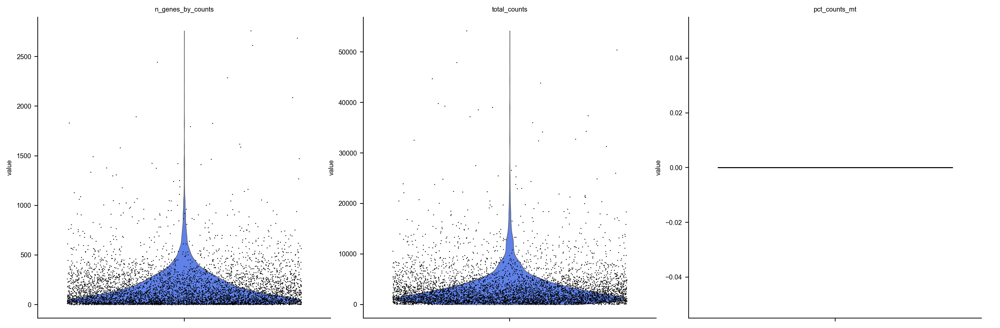

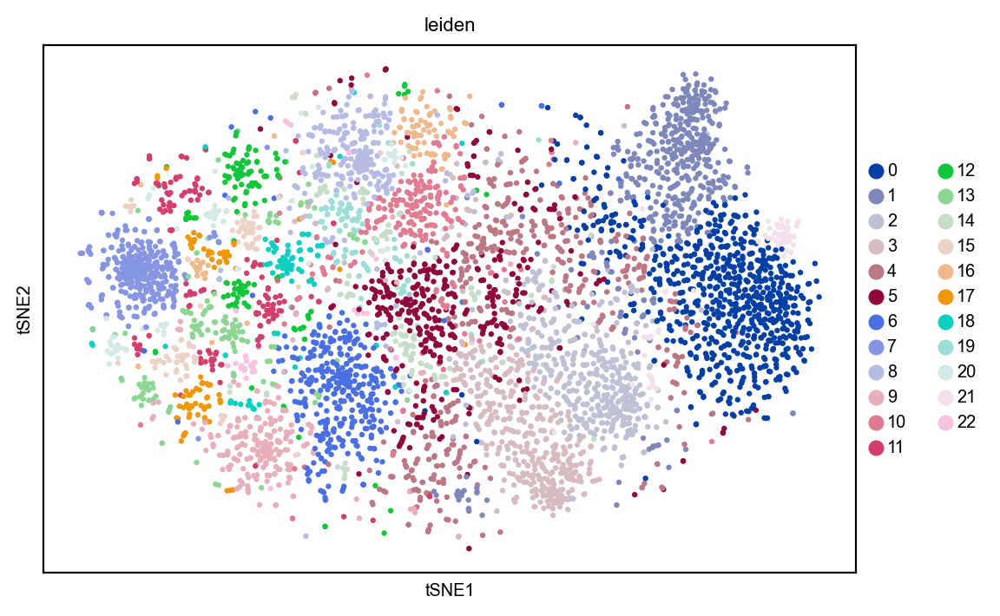

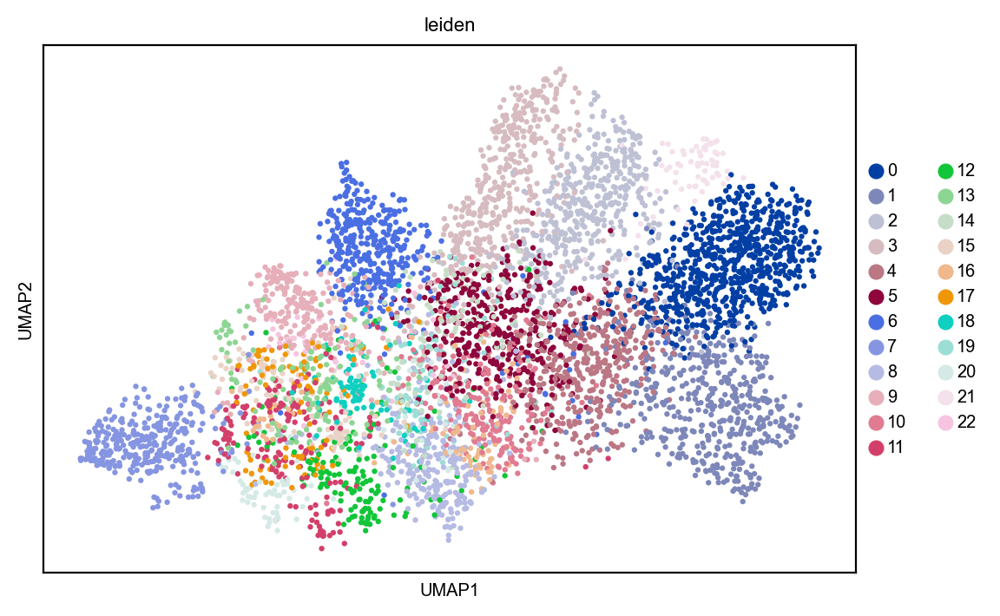

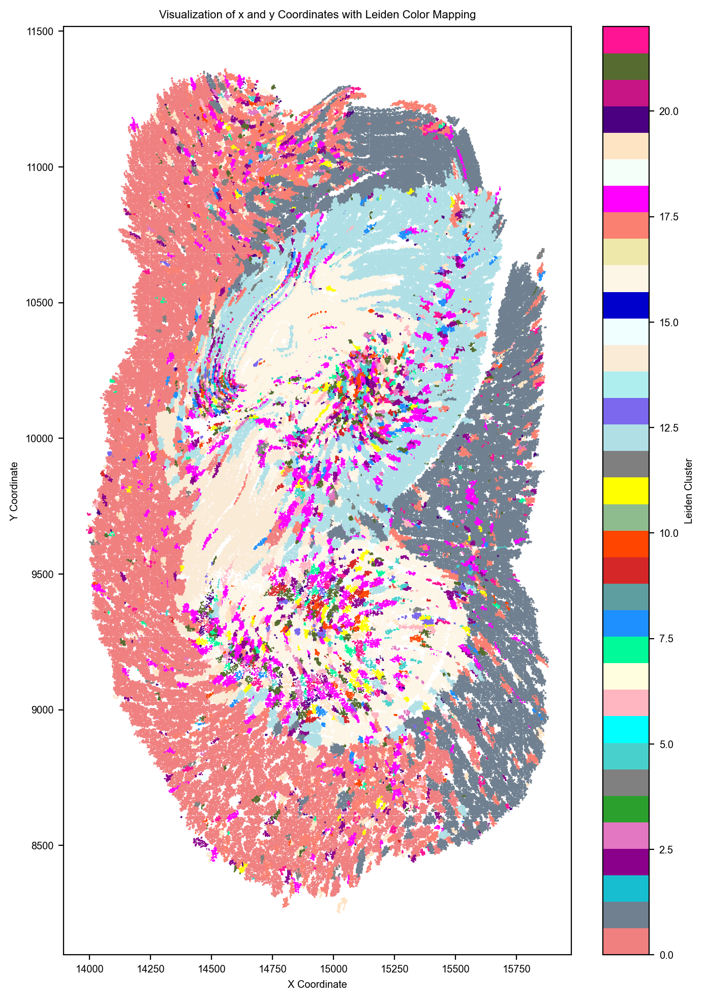

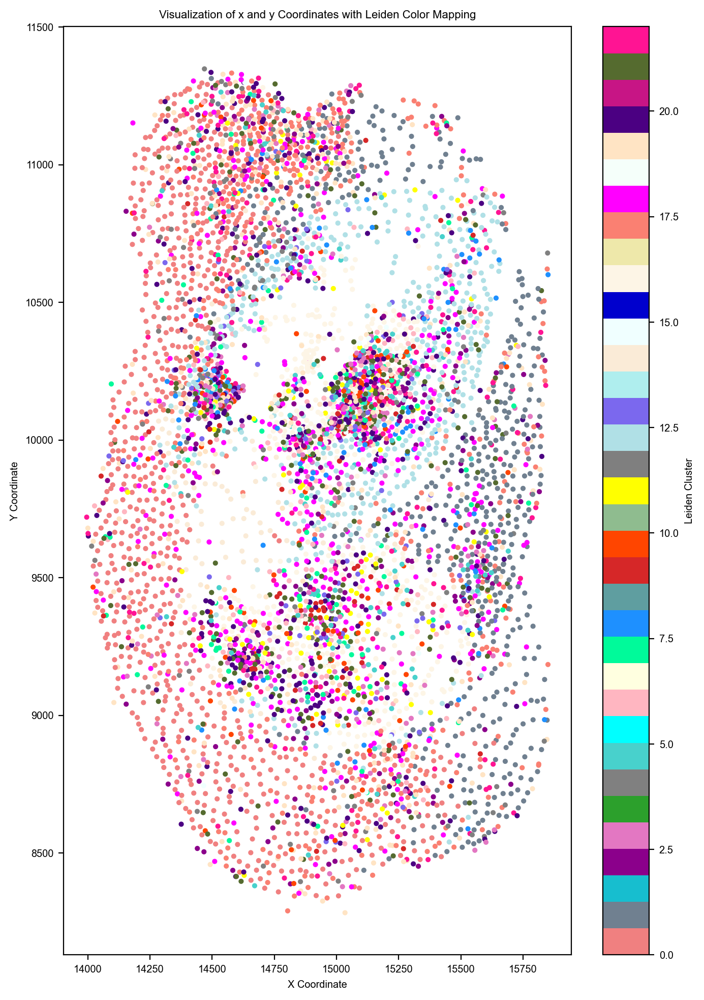

In [38]:
import matplotlib.colors as mcolors

# Assuming merged_df and 'leiden_numeric' are already defined
# Manually selecting 40 distinct colors from matplotlib
colors = list(mcolors.TABLEAU_COLORS.values()) + list(mcolors.CSS4_COLORS.values())
# Randomly shuffle or select 40 colors
np.random.shuffle(colors)
selected_colors = colors[:35]

counts_scale = gene_expression_matrix_scale
adata_scale = ad.AnnData(X=counts_scale.T)

# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata_scale.var["mt"] = adata_scale.var_names.str.startswith("MT-")
# ribosomal genes
adata_scale.var["ribo"] = adata_scale.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata_scale.var["hb"] = adata_scale.var_names.str.contains("^HB[^(P)]")
sc.pp.calculate_qc_metrics(
    adata_scale, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

sc.pp.filter_cells(adata_scale, min_genes=0)                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
sc.pp.filter_cells(adata_scale, max_genes=3000)
sc.pp.filter_genes(adata_scale, min_cells=1)

sc.pl.violin(
    adata_scale,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

# sc.pl.scatter(adata_scale, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

# Saving count data
adata_scale.layers["counts"] = adata_scale.X.copy()
# Normalizing to median total counts
sc.pp.normalize_total(adata_scale)
# Logarithmize the data
sc.pp.log1p(adata_scale)
sc.pp.highly_variable_genes(adata_scale, n_top_genes=30000)
# sc.pl.highly_variable_genes(adata_scale)

sc.tl.pca(adata_scale)
# sc.pl.pca_variance_ratio(adata_scale, n_pcs=50, log=True)
# sc.pl.pca(
#     adata_scale,
#     dimensions=[(0, 1), (2, 3), (0, 1), (2, 3)],
#     ncols=2,
#     size=2,
# )

sc.pp.neighbors(adata_scale)
# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(adata_scale, flavor="leidenalg", resolution=1.7, n_iterations=2)
sc.tl.tsne(adata_scale)
sc.pl.tsne(adata_scale, color=["leiden"])
sc.tl.umap(adata_scale)
sc.pl.umap(adata_scale, color=["leiden"])

import pandas as pd

# 假设 adata 和 coor_matched 已经加载
# 将 '3D_cellbarcode' 列转换为字符串类型
adata_scale.obs['cellbarcode'] = adata_scale.obs.index.astype(str)
coor_matched['3D_cellbarcode'] = coor_matched['3D_cellbarcode'].astype(str)
merged_df = adata_scale.obs.merge(coor_matched[['3D_cellbarcode', 'x', 'y', 'TPS_x', 'TPS_y']], 
                            left_on='cellbarcode',  # 这里是 adata.obs 中的列名
                            right_on='3D_cellbarcode',        # 这里是 coor_matched 中的列名
                            how='left')

import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Assuming merged_df is the DataFrame you're working with

# Convert 'leiden' from categorical to numeric (if it's a categorical type)
if merged_df['leiden'].dtype.name == 'category':
    label_encoder = LabelEncoder()
    merged_df['leiden_numeric'] = label_encoder.fit_transform(merged_df['leiden'])
else:
    merged_df['leiden_numeric'] = merged_df['leiden'].astype(int)

# Create the scatter plot using the numeric 'leiden_numeric' column
plt.figure(figsize=(8, 12))
plt.scatter(merged_df['x'], merged_df['y'], c=merged_df['leiden_numeric'], cmap=plt.cm.colors.ListedColormap(selected_colors), s=0.2)
plt.colorbar(label='Leiden Cluster')
plt.title('Visualization of x and y Coordinates with Leiden Color Mapping')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.show()

# 按照 '3D_cellbarcode' 分组，计算每组的质心
centroids_df = merged_df.groupby('3D_cellbarcode').agg({
    'x': 'mean',
    'y': 'mean',
    'leiden_numeric': 'mean'
}).reset_index()

plt.figure(figsize=(8, 12))
plt.scatter(centroids_df['x'], centroids_df['y'], c=centroids_df['leiden_numeric'], cmap=plt.cm.colors.ListedColormap(selected_colors), s=10)
plt.colorbar(label='Leiden Cluster')
plt.title('Visualization of x and y Coordinates with Leiden Color Mapping')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.show()

合并cellbin数据 生成cell_3D表达矩阵

In [ ]:
index = 100  # 随机选一个点
print("点坐标:", interpolated_pc_vtk.points[index])
print("点的 group:", interpolated_pc_vtk.point_data["groups"][index])
print("点的 RGBA 颜色:", interpolated_pc_vtk.point_data["groups_rgba"][index])


点坐标: [222. 548.  18.]
点的 group: same
点的 RGBA 颜色: [0.5019608 0.        1.        1.       ]


In [ ]:
import cupy as cp
import numpy as np
from tqdm.notebook import tqdm

# 1. 读取 interpolated_pc_vtk 里的点
vtk_points = cp.array(interpolated_pc_vtk.points, dtype=cp.int32)  # (N, 3) 形状
num_points = vtk_points.shape[0]
print("✅ 读取点云数据完成")

# 2. 读取 txt 解析出的点云
anno_points = cp.array(np.column_stack((x_anno, y_anno, z_anno)), dtype=cp.int32)  # (M, 3)
anno_values = cp.array(anno_grayscale, dtype=cp.float32)  # (M,)
print("✅ 读取 txt 数据完成")

# 3. **优化：一次性转换整个数组到 CPU，避免逐点 get()**
anno_points_cpu = anno_points.get()  # (M, 3)
anno_values_cpu = anno_values.get()  # (M,)

# 4. **在 CPU 上构建哈希映射**
anno_dict = {tuple(point): value for point, value in zip(anno_points_cpu, anno_values_cpu)}
print("✅ 构建哈希映射完成，开始匹配...")

# 5. 初始化结果数组（全 0）
matched_grayscale = cp.zeros(num_points, dtype=cp.float32)

# 6. **GPU 计算同步，确保 tqdm 立即显示**
cp.cuda.Device(0).synchronize()

# 7. 遍历 interpolated_pc_vtk.points 进行匹配（GPU 加速 + 进度条）
for i in tqdm(range(num_points), desc="GPU 匹配进度", unit="点"):
    matched_grayscale[i] = anno_dict.get(tuple(vtk_points[i].get()), 0)  # 匹配失败填 0

# 8. 传输回 CPU 并存入 interpolated_pc_vtk.point_data
interpolated_pc_vtk.point_data["groups"] = matched_grayscale.get()

print("✅ GPU 匹配完成！")



GPU 匹配进度:   0%|          | 0/159556 [00:00<?, ?点/s]

✅ GPU 匹配完成！


In [63]:
import numpy as np
import open3d as o3d
import matplotlib.pyplot as plt

# 获取三维点坐标 (N, 3)
points = np.array(interpolated_pc_vtk_anno.points)

# 获取对应的像素值 (N,)
pixel_values = np.array(interpolated_pc_vtk_anno.point_data["groups"])

# 设置想要可视化的多个像素值
specified_values = [3, 5, 6, 7]  # 例如，显示像素值为 3, 5, 7 的点

# 根据像素值筛选符合条件的点
selected_points = points[np.isin(pixel_values, specified_values)]

# 如果选定的点为空，可以提前检查
if selected_points.shape[0] == 0:
    print(f"没有找到指定像素值的点：{specified_values}")
else:
    # 创建 Open3D 点云对象
    pcd = o3d.geometry.PointCloud()

    # 设置点云的坐标数据
    pcd.points = o3d.utility.Vector3dVector(selected_points)

    # 根据像素值为点设置颜色
    colors = []
    for value in pixel_values[np.isin(pixel_values, specified_values)]:
        # 使用 matplotlib 的颜色映射
        cmap = plt.get_cmap("viridis")  # 颜色映射，如 'viridis'
        colors.append(cmap(value / max(specified_values))[:3])  # 设置不同像素值的颜色

    # 设置点云的颜色数据
    pcd.colors = o3d.utility.Vector3dVector(colors)

    # 可视化点云
    o3d.visualization.draw_geometries([pcd])


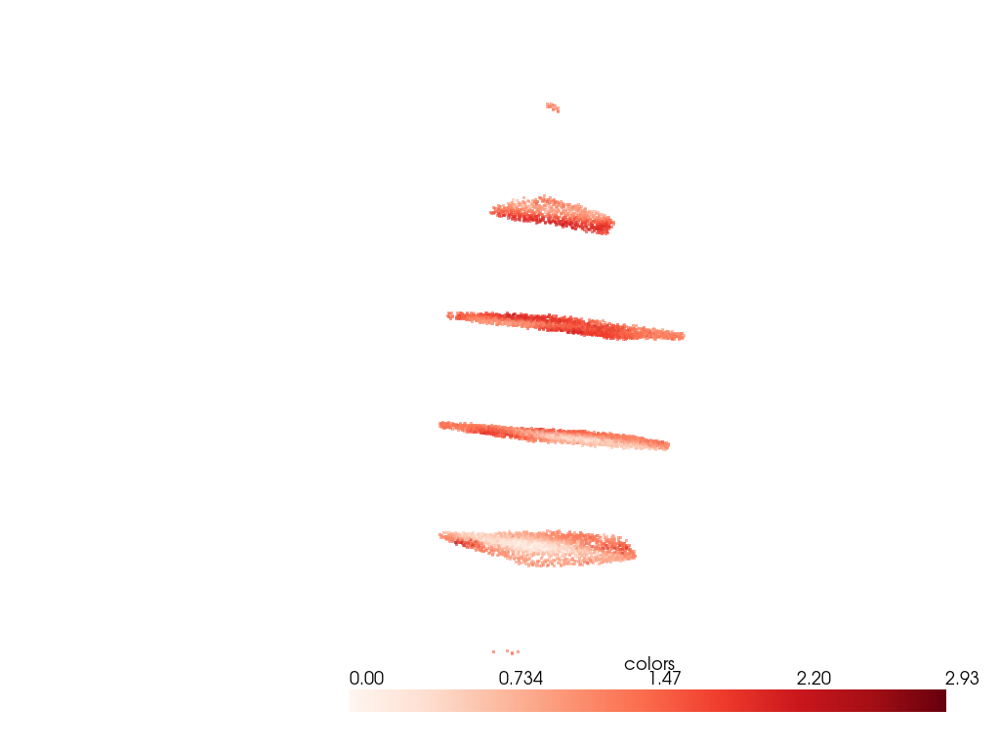

当前视角参数: [(35.5838361410263, 508.5005428382385, -2298.8192481277147),
 (346.58416192111844, 522.8515308770109, 240.375),
 (0.09106479633679405, 0.995703568859181, -0.016781115255802417)]


In [64]:
# 使用示例
gene_name = "Os02g0587000"  # 可视化的基因名
n_slices = 5  # 切片数
visualize_single_gene_in3D(interpolated_pc_vtk_anno, gene_name, n_slices)

Visualizing gene: Os10g0361000...


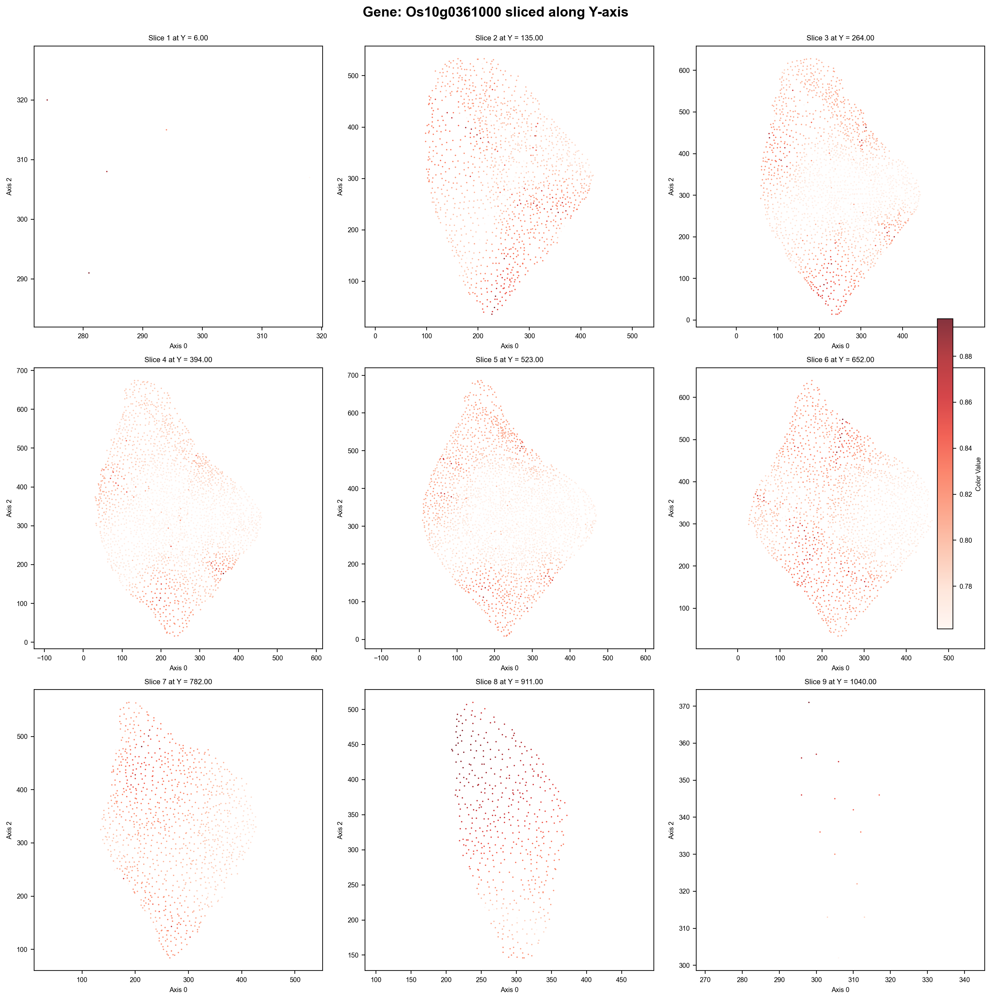

Gene Os10g0361000 slices saved to: C:/Users/SNM/Desktop/1/Os10g0361000-y.png


In [31]:
# 使用示例
gene_name = "Os10g0361000"  # 要可视化的基因名
slice_axis = 'y'  # 切片方向 ('x', 'y', 'z')
n_slices = 9  # 切片数量
n_cols = 3  # 每行展示的切片数
output_dir = "C:/Users/SNM/Desktop/1/"  # 输出目录
visualize_single_gene_inMultiSilce(interpolated_pc_vtk, slice_axis, n_slices, n_cols, output_dir, gene_name)

In [ ]:
for gene in genes:
    visualize_single_gene_inMultiSilce(interpolated_pc, slice_axis, n_slices, n_cols, output_dir, gene)